# Lab 3: Generating Data

Based on assignments by Lisa Zhang and Jimmy Ba.

In this lab, you will build models to perform image colourization. That is, given a greyscale image, we wish to predict the colour at each pixel. Image colourization is a difficult problem for many reasons, one of which being that it is ill-posed: for a single greyscale image, there can be multiple, equally valid colourings.

To keep the training time manageable we will use the CIFAR-10 data set, which consists of images of size 32x32 pixels. For most of the questions we will use a subset of the dataset. The data loading script is included with the notebooks, and should download automatically the first time it is loaded. 

We will be starting with a convolutional autoencoder and tweaking it along the way to improve our perforamnce. Then as a second part of the assignment we will compare the autoencoder approach to conditional generative adversarial networks (cGANs).

In the process, you are expected to learn to:

1. Clean and process the dataset and create greyscale images.
2. Implement and modify an autoencoder architecture.
3. Tune the hyperparameters of an autoencoder.
4. Implement skip connections and other techniques to improve performance.
5. Implement a cGAN and compare with an autoencoder.
6. Improve on the cGAN by trying one of several techniques to enhance training.


### What to submit

Submit an HTML file containing all your code, outputs, and write-up
from parts A and B. You can produce a HTML file directly from Google Colab. The Colab instructions are provided at the end of this document.

**Do not submit any other files produced by your code.**

Include a link to your colab file in your submission.

Please use Google Colab to complete this assignment. If you want to use Jupyter Notebook, please complete the assignment and upload your Jupyter Notebook file to Google Colab for submission. 

## Colab Link

Include a link to your Colab file here. If you would like the TA to look at your
Colab file in case your solutions are cut off, **please make sure that your Colab
file is publicly accessible at the time of submission**.

Colab Link:https://colab.research.google.com/drive/1bvDIoaAUpsdRS0ODWXhL9wmLwVMInlZx#scrollTo=QOGjb0yLTx6d

# PART A - Autoencoder [20 pt]

In this part we will construct and compare different autoencoder models for the image colourization task.

#### Helper code

Provided are some helper functions for loading and preparing the data. Note that you will need to use the Colab GPU for this assignment.

In [88]:
"""
Colourization of CIFAR-10 Horses via classification.
"""
import argparse
import math
import time
import os
from glob import glob

import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import numpy.random as npr
import scipy.misc
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Variable


In [89]:
######################################################################
# Setup working directory
######################################################################
%mkdir -p /content/a3/
%cd /content/a3


/content/a3


In [90]:
######################################################################
# Helper functions for loading data
######################################################################
# adapted from
# https://github.com/fchollet/keras/blob/master/keras/datasets/cifar10.py

import os
import pickle
import sys
import tarfile

import numpy as np
from PIL import Image
from six.moves.urllib.request import urlretrieve


def get_file(fname, origin, untar=False, extract=False, archive_format="auto", cache_dir="data"):
    datadir = os.path.join(cache_dir)
    if not os.path.exists(datadir):
        os.makedirs(datadir)

    if untar:
        untar_fpath = os.path.join(datadir, fname)
        fpath = untar_fpath + ".tar.gz"
    else:
        fpath = os.path.join(datadir, fname)

    print("File path: %s" % fpath)
    if not os.path.exists(fpath):
        print("Downloading data from", origin)

        error_msg = "URL fetch failure on {}: {} -- {}"
        try:
            try:
                urlretrieve(origin, fpath)
            except URLError as e:
                raise Exception(error_msg.format(origin, e.errno, e.reason))
            except HTTPError as e:
                raise Exception(error_msg.format(origin, e.code, e.msg))
        except (Exception, KeyboardInterrupt) as e:
            if os.path.exists(fpath):
                os.remove(fpath)
            raise

    if untar:
        if not os.path.exists(untar_fpath):
            print("Extracting file.")
            with tarfile.open(fpath) as archive:
                archive.extractall(datadir)
        return untar_fpath

    if extract:
        _extract_archive(fpath, datadir, archive_format)

    return fpath


def load_batch(fpath, label_key="labels"):
    """Internal utility for parsing CIFAR data.
    # Arguments
        fpath: path the file to parse.
        label_key: key for label data in the retrieve
            dictionary.
    # Returns
        A tuple `(data, labels)`.
    """
    f = open(fpath, "rb")
    if sys.version_info < (3,):
        d = pickle.load(f)
    else:
        d = pickle.load(f, encoding="bytes")
        # decode utf8
        d_decoded = {}
        for k, v in d.items():
            d_decoded[k.decode("utf8")] = v
        d = d_decoded
    f.close()
    data = d["data"]
    labels = d[label_key]

    data = data.reshape(data.shape[0], 3, 32, 32)
    return data, labels


def load_cifar10(transpose=False):
    """Loads CIFAR10 dataset.
    # Returns
        Tuple of Numpy arrays: `(x_train, y_train), (x_test, y_test)`.
    """
    dirname = "cifar-10-batches-py"
    origin = "http://www.cs.toronto.edu/~kriz/cifar-10-python.tar.gz"
    path = get_file(dirname, origin=origin, untar=True)

    num_train_samples = 50000

    x_train = np.zeros((num_train_samples, 3, 32, 32), dtype="uint8")
    y_train = np.zeros((num_train_samples,), dtype="uint8")

    for i in range(1, 6):
        fpath = os.path.join(path, "data_batch_" + str(i))
        data, labels = load_batch(fpath)
        x_train[(i - 1) * 10000 : i * 10000, :, :, :] = data
        y_train[(i - 1) * 10000 : i * 10000] = labels

    fpath = os.path.join(path, "test_batch")
    x_test, y_test = load_batch(fpath)

    y_train = np.reshape(y_train, (len(y_train), 1))
    y_test = np.reshape(y_test, (len(y_test), 1))

    if transpose:
        x_train = x_train.transpose(0, 2, 3, 1)
        x_test = x_test.transpose(0, 2, 3, 1)
    return (x_train, y_train), (x_test, y_test)

In [91]:
# Download CIFAR dataset
m = load_cifar10()

File path: data/cifar-10-batches-py.tar.gz


## Part 1. Data Preparation [7 pt]

To start off run the above code to load the CIFAR dataset and then work through the following questions/tasks. 

### Part (a) [1pt]
Verify that the dataset has loaded correctly. How many samples do we have? How is the data organized?

In [92]:
print("Shape of Train Data:",m[0][0].shape)
print("Shape of Train Labels:",m[0][1].shape)

print("Shape of Test Data:",m[1][0].shape)
print("Shape of Test Labels:",m[1][1].shape)

Shape of Train Data: (50000, 3, 32, 32)
Shape of Train Labels: (50000, 1)
Shape of Test Data: (10000, 3, 32, 32)
Shape of Test Labels: (10000, 1)


In [93]:
print(m[0][0][0,0])

[[ 59  43  50 ... 158 152 148]
 [ 16   0  18 ... 123 119 122]
 [ 25  16  49 ... 118 120 109]
 ...
 [208 201 198 ... 160  56  53]
 [180 173 186 ... 184  97  83]
 [177 168 179 ... 216 151 123]]


When we load the dataset we get a tuple of Train and Test data as output. Which evident from above code. We have 50000 train samples and 10000 test samples of RGB images.

### Part (b) [2pt]
Preprocess the data to select only images of horses. Learning to generate only hourse images will make our task easier. Your function will also convert the colour images to greyscale to create our input data.

In [94]:
#try rgb to grey
from skimage import color
from skimage import io

In [95]:
# select a single category.
HORSE_CATEGORY = 7

# convert colour images into greyscale
def process(xs, ys, max_pixel=256.0, downsize_input=False):
    """
    Pre-process CIFAR10 images by taking only the horse category,
    shuffling, and have colour values be bound between 0 and 1

    Args:
      xs: the colour RGB pixel values
      ys: the category labels
      max_pixel: maximum pixel value in the original data
    Returns:
      xs: value normalized and shuffled colour images
      grey: greyscale images, also normalized so values are between 0 and 1
    """
    xs = xs / max_pixel
    xs = xs[np.where(ys == HORSE_CATEGORY)[0], :, :, :]
    npr.shuffle(xs)

    grey = np.mean(xs, axis=1, keepdims=True)
    #grey = color.rgb2gray(xs)

    if downsize_input:
        downsize_module = nn.Sequential(
            nn.AvgPool2d(2),
            nn.AvgPool2d(2),
            nn.Upsample(scale_factor=2),
            nn.Upsample(scale_factor=2),
        )
        xs_downsized = downsize_module.forward(torch.from_numpy(xs).float())
        xs_downsized = xs_downsized.data.numpy()
        return (xs, xs_downsized)
    else:
        return (xs, grey)


In [96]:
input_data = process(m[0][0], m[0][1], max_pixel=256.0, downsize_input=False)

In [97]:
m[0][1]

array([[6],
       [9],
       [9],
       ...,
       [9],
       [1],
       [1]], dtype=uint8)

### Part (c) [2pt]
Create a dataloader (or function) to batch the samples.

In [98]:
# dataloader for batching samples

def get_batch(x, y, batch_size):
    """
    Generated that yields batches of data

    Args:
      x: input values
      y: output values
      batch_size: size of each batch
    Yields:
      batch_x: a batch of inputs of size at most batch_size
      batch_y: a batch of outputs of size at most batch_size
    """
    N = np.shape(x)[0]
    assert N == np.shape(y)[0]
    for i in range(0, N, batch_size):
        batch_x = x[i : i + batch_size, :, :, :]
        batch_y = y[i : i + batch_size, :, :, :]
        yield (batch_x, batch_y)

In [99]:
train_loader = get_batch(input_data[1], m[0][1], 32)

### Part (e) [2pt]
Verify and visualize that we are able to generate different batches of data.

In [100]:
# code to load different batches of horse dataset

print("Loading data...")
(x_train, y_train), (x_test, y_test) = load_cifar10()

print("Transforming data...")
train_rgb, train_grey = process(x_train, y_train)
test_rgb, test_grey = process(x_test, y_test)


Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...


In [101]:
# shape of data and labels before selection
print(x_train.shape, y_train.shape)

(50000, 3, 32, 32) (50000, 1)


In [102]:
# shape of training data
print('Training Data: ', train_rgb.shape, train_grey.shape)
# shape of testing data
print('Testing Data: ', test_rgb.shape, test_grey.shape)

Training Data:  (5000, 3, 32, 32) (5000, 1, 32, 32)
Testing Data:  (1000, 3, 32, 32) (1000, 1, 32, 32)


In [103]:
# shape of training data
print('Training Data: ', train_rgb.shape, train_grey.shape)
# shape of testing data
print('Testing Data: ', test_rgb.shape, test_grey.shape)

Training Data:  (5000, 3, 32, 32) (5000, 1, 32, 32)
Testing Data:  (1000, 3, 32, 32) (1000, 1, 32, 32)


Load Batches

In [104]:
# obtain batches of images
xs, ys = next(iter(get_batch(train_grey, train_rgb, 10)))
print(xs.shape, ys.shape)

(10, 1, 32, 32) (10, 3, 32, 32)


Visualization

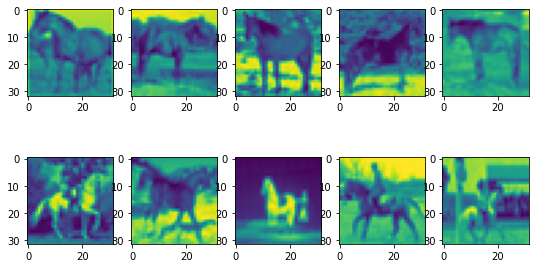

In [105]:
# visualize 5 train/test images

plt.figure(figsize=(9, 5))
#train = train_grey.numpy()
#test = test_grey.numpy()
for i,img in enumerate(train_grey):
    if i >= 5: break
    plt.subplot(2, 5, i+1)
    img = img.reshape((32,32))
    plt.imshow(img)
 
for i,img in enumerate(test_grey):
    if i >= 5: break
    plt.subplot(2, 5, 5+i+1)
    img = img.reshape((32,32))
    plt.imshow(img)

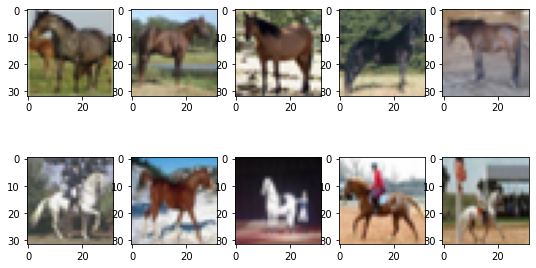

In [106]:
plt.figure(figsize=(9, 5))
#train = train_grey.numpy()
#test = test_grey.numpy()
for i,img in enumerate(train_rgb):
    if i >= 5: break
    plt.subplot(2, 5, i+1)
    img = img.swapaxes(0,1)
    img = img.swapaxes(1,2)
    plt.imshow(img)
 
for i,img in enumerate(test_rgb):
    if i >= 5: break
    plt.subplot(2, 5, 5+i+1)
    img = img.swapaxes(0,1)
    img = img.swapaxes(1,2)
    plt.imshow(img)

## Part 2. Colourization as Regression [5 pt]

There are many ways to frame the problem of image colourization as a machine learning problem. One naive approach is to frame it as a regression problem, where we build a model to predict the RGB intensities at each pixel given the greyscale input. In this case, the outputs are continuous, and so squared error can be used to train the model.

In this section, you will get familar with training neural networks using cloud GPUs. Run the helper code and answer the questions that follow.

#### Helper Code

Regression Architecture

In [107]:
class RegressionCNN(nn.Module):
    def __init__(self, kernel, num_filters):
        # first call parent's initialization function
        super().__init__()
        padding = kernel // 2

        self.downconv1 = nn.Sequential(
            nn.Conv2d(1, num_filters, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters),
            nn.ReLU(),
            nn.MaxPool2d(2),)
        self.downconv2 = nn.Sequential(
            nn.Conv2d(num_filters, num_filters*2, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters*2),
            nn.ReLU(),
            nn.MaxPool2d(2),)

        self.rfconv = nn.Sequential(
            nn.Conv2d(num_filters*2, num_filters*2, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters*2),
            nn.ReLU())

        self.upconv1 = nn.Sequential(
            nn.Conv2d(num_filters*2, num_filters, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters),
            nn.ReLU(),
            nn.Upsample(scale_factor=2),)
        self.upconv2 = nn.Sequential(
            nn.Conv2d(num_filters, 3, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(3),
            nn.ReLU(),
            nn.Upsample(scale_factor=2),)
        self.finalconv = nn.Conv2d(3, 3, kernel_size=kernel, padding=padding)

    def forward(self, x):
        out = self.downconv1(x)
        out = self.downconv2(out)
        out = self.rfconv(out)
        out = self.upconv1(out)
        out = self.upconv2(out)
        out = self.finalconv(out)
        return out

Training code

In [108]:
class AttrDict(dict):
    def __init__(self, *args, **kwargs):
        super(AttrDict, self).__init__(*args, **kwargs)
        self.__dict__ = self

def get_torch_vars(xs, ys, gpu=False):
    """
    Helper function to convert numpy arrays to pytorch tensors.
    If GPU is used, move the tensors to GPU.

    Args:
      xs (float numpy tenosor): greyscale input
      ys (int numpy tenosor): rgb as labels
      gpu (bool): whether to move pytorch tensor to GPU
    Returns:
      Variable(xs), Variable(ys)
    """
    xs = torch.from_numpy(xs).float()
    ys = torch.from_numpy(ys).float()
    if gpu:
        xs = xs.cuda()
        ys = ys.cuda()
    return Variable(xs), Variable(ys)

def train(args, gen=None):

    # Numpy random seed
    npr.seed(args.seed)

    # Save directory
    save_dir = "outputs/" + args.experiment_name

    # LOAD THE MODEL
    if gen is None:
        Net = globals()[args.model]
        gen = Net(args.kernel, args.num_filters)

    # LOSS FUNCTION
    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(gen.parameters(), lr=args.learn_rate)

    # DATA
    print("Loading data...")
    (x_train, y_train), (x_test, y_test) = load_cifar10()

    print("Transforming data...")
    train_rgb, train_grey = process(x_train, y_train, downsize_input=args.downsize_input)
    test_rgb, test_grey = process(x_test, y_test, downsize_input=args.downsize_input)

    # Create the outputs folder if not created already
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)

    print("Beginning training ...")
    if args.gpu:
        gen.cuda()
    start = time.time()

    train_losses = np.zeros(args.epochs)
    valid_losses = np.zeros(args.epochs)
    valid_accs = []

    for epoch in range(args.epochs):
        # Train the Model
        gen.train()  # Change model to 'train' mode
        #losses = []
        total_train_loss = 0
        total_val_loss = 0
        for i, (xs, ys) in enumerate(get_batch(train_grey, train_rgb, args.batch_size)):
            images_train, labels_train = get_torch_vars(xs, ys, args.gpu)
            # Forward + Backward + Optimize
            optimizer.zero_grad()
            outputs_train = gen(images_train)

            train_loss = criterion(outputs_train, labels_train)
            train_loss.backward()
            optimizer.step()
            total_train_loss += train_loss.data.item()
        train_losses[epoch] = float(total_train_loss) / (i+1)
        print(epoch,"Train Losses:", train_losses[epoch])

        gen.eval()
        for i, (xs, ys) in enumerate(get_batch(test_grey, test_rgb, args.batch_size)):
            images_val, labels_val = get_torch_vars(xs, ys, args.gpu)
            outputs_val = gen(images_val)
            val_loss = criterion(outputs_val, labels_val)

            total_val_loss += val_loss.data.item()    
        valid_losses[epoch] = float(total_val_loss) / (i+1)
        print(epoch, "Validation Losses:", valid_losses[epoch])
        print("Train Images Results")
        if args.plot:
          visual(images_train, labels_train, outputs_train, args.gpu, 1)
    print("Final Validation Images Results")
    if args.plot:
          visual(images_val, labels_val, outputs_val, args.gpu, 1)
    plt.subplots(figsize=(6, 4))
    plt.plot(range(epoch+1), train_losses, color="blue", label="Training Set")
    plt.plot(range(epoch+1), valid_losses, color="red", label="Validation Set")
    plt.legend()
    plt.xlabel("Number of Epochs")
    plt.ylabel("Loss")
    plt.show()
    
    return gen

Training visualization code

In [109]:
# visualize 5 train/test images
def visual(img_grey, img_real, img_fake, gpu = 0, flag_torch = 0):

  if gpu:
    img_grey = img_grey.cpu().detach()
    img_real = img_real.cpu().detach()
    #print(img_real.shape)
    img_fake = img_fake.cpu().detach()

  if flag_torch:
    img_grey = img_grey.numpy()
    img_real = img_real.numpy()
    img_fake = img_fake.numpy()

  if flag_torch == 2:
    img_real = np.transpose(img_real[:, :, :, :, :], [0, 4, 2, 3, 1]).squeeze()
    img_fake = np.transpose(img_fake[:, :, :, :, :], [0, 4, 2, 3, 1]).squeeze()

  #correct image structure
  img_grey = np.transpose(img_grey[:5, :, :, :], [0, 2, 3, 1]).squeeze()
  img_fake = np.transpose(img_fake[:5, :, :, :], [0, 2, 3, 1])
  img_real = np.transpose(img_real[:5, :, :, :], [0, 2, 3, 1])
  
  for i in range(5):
      ax = plt.subplot(3, 5, i + 1)
      ax.imshow(img_grey[i], cmap='gray')
      ax.axis("off")
      ax = plt.subplot(3, 5, i + 1 + 5)
      ax.imshow(img_real[i])
      ax.axis("off")
      ax = plt.subplot(3, 5, i + 1 + 10)
      ax.imshow(img_fake[i])
      ax.axis("off")
  plt.show()

Main training loop for regression CNN

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...


0 Train Losses: 0.1840725438296795
0 Validation Losses: 0.07063328474760056
Train Images Results


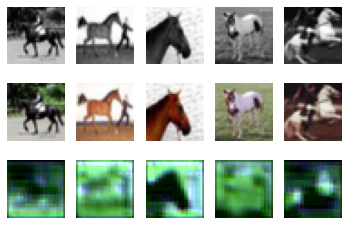

1 Train Losses: 0.03231175500899553
1 Validation Losses: 0.02155999541282654
Train Images Results


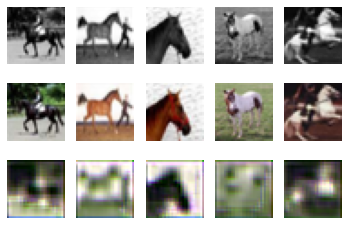

2 Train Losses: 0.019363679140806198
2 Validation Losses: 0.018090092204511167
Train Images Results


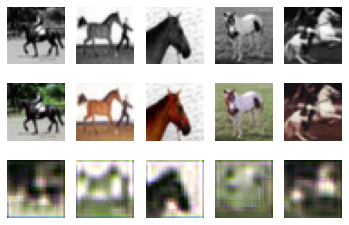

3 Train Losses: 0.016938829962164163
3 Validation Losses: 0.016237556282430888
Train Images Results


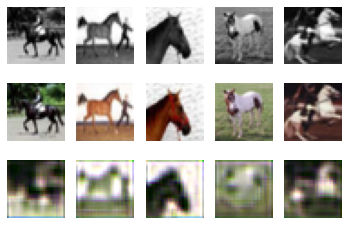

4 Train Losses: 0.015447826758027076
4 Validation Losses: 0.015039210766553878
Train Images Results


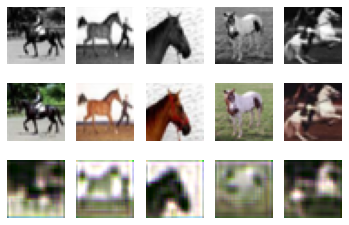

5 Train Losses: 0.0143352510035038
5 Validation Losses: 0.014012213889509439
Train Images Results


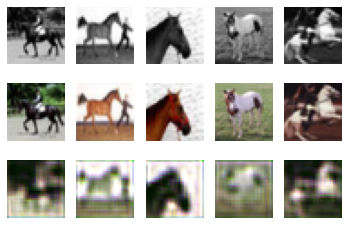

6 Train Losses: 0.013476680424064398
6 Validation Losses: 0.01318802209571004
Train Images Results


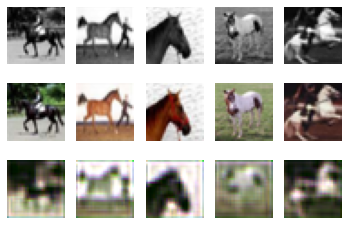

7 Train Losses: 0.012843137737363577
7 Validation Losses: 0.012567698769271374
Train Images Results


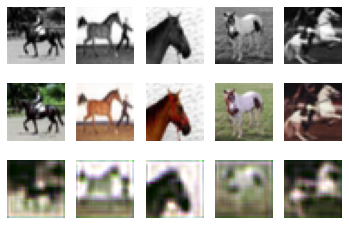

8 Train Losses: 0.012329942379146815
8 Validation Losses: 0.012075242772698402
Train Images Results


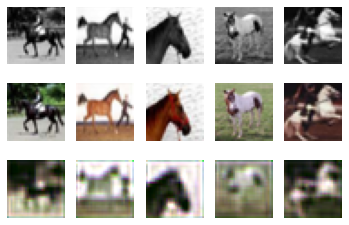

9 Train Losses: 0.011889470610767602
9 Validation Losses: 0.011669040843844413
Train Images Results


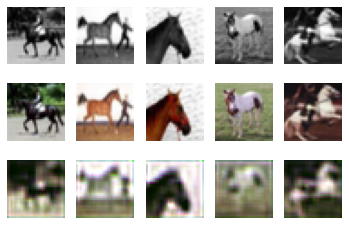

10 Train Losses: 0.011514129601418972
10 Validation Losses: 0.011320482939481735
Train Images Results


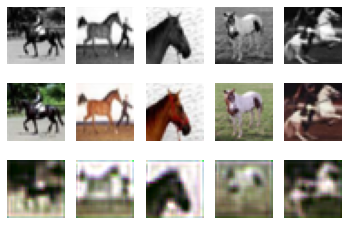

11 Train Losses: 0.011187673062086106
11 Validation Losses: 0.011031293403357267
Train Images Results


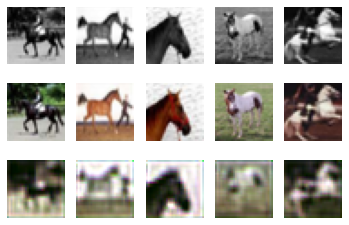

12 Train Losses: 0.010901787970215081
12 Validation Losses: 0.010774346347898246
Train Images Results


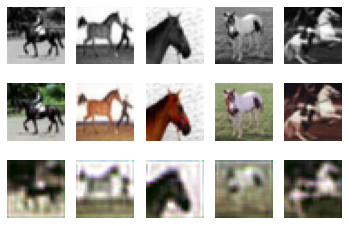

13 Train Losses: 0.010646219626069068
13 Validation Losses: 0.010547604411840439
Train Images Results


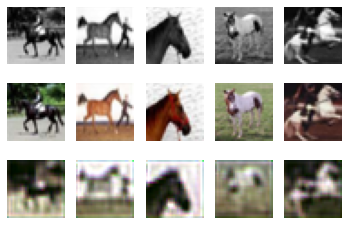

14 Train Losses: 0.010416221171617508
14 Validation Losses: 0.010334601625800133
Train Images Results


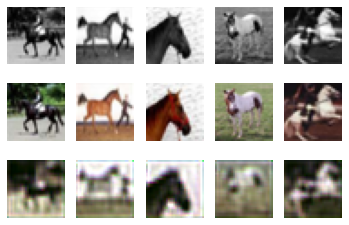

15 Train Losses: 0.010206490978598595
15 Validation Losses: 0.010130691900849342
Train Images Results


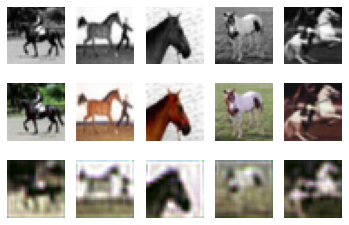

16 Train Losses: 0.010013048853725195
16 Validation Losses: 0.009942553285509349
Train Images Results


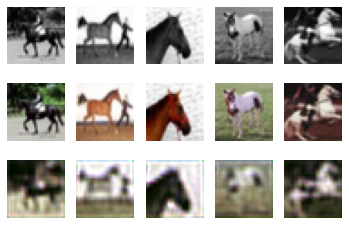

17 Train Losses: 0.009832115452736616
17 Validation Losses: 0.009752895403653383
Train Images Results


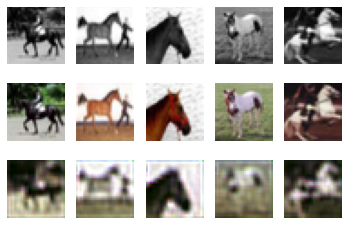

18 Train Losses: 0.009657522533088922
18 Validation Losses: 0.009584399964660406
Train Images Results


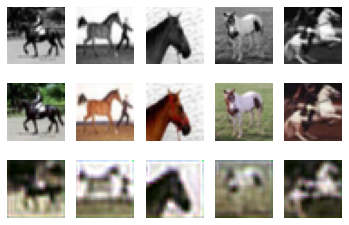

19 Train Losses: 0.009491814095526933
19 Validation Losses: 0.009425470326095819
Train Images Results


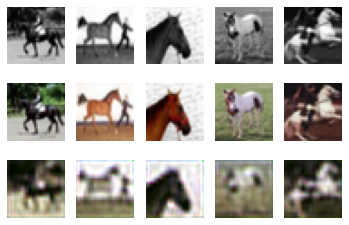

20 Train Losses: 0.009341682884842157
20 Validation Losses: 0.009288414288312197
Train Images Results


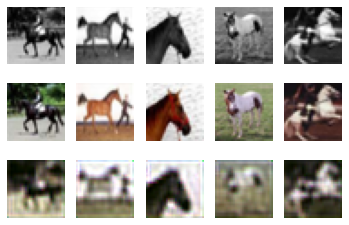

21 Train Losses: 0.009201485961675644
21 Validation Losses: 0.009151119366288185
Train Images Results


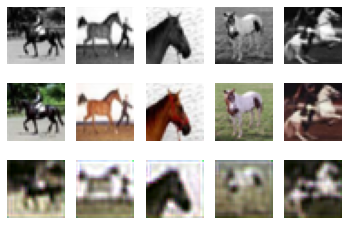

22 Train Losses: 0.009070639219135045
22 Validation Losses: 0.009034494031220674
Train Images Results


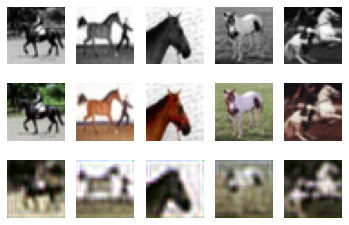

23 Train Losses: 0.008948354199528694
23 Validation Losses: 0.00891748871654272
Train Images Results


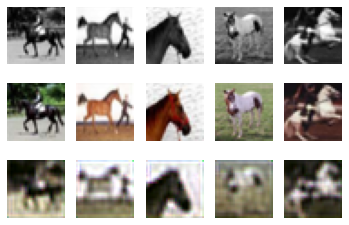

24 Train Losses: 0.008831207882612943
24 Validation Losses: 0.00879953233525157
Train Images Results


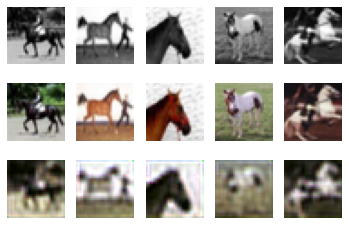

Final Validation Images Results


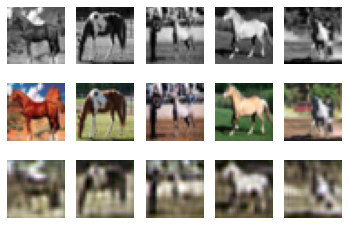

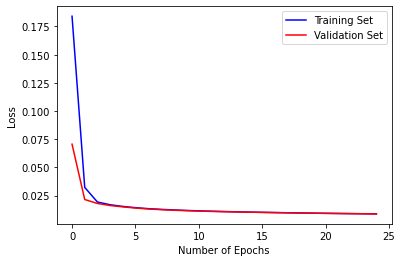

In [110]:
#Main training loop for CNN
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "RegressionCNN",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001, 
    "batch_size": 100,
    "epochs": 25,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}

args.update(args_dict)
cnn = train(args)

### Part (a) [1 pt]
Describe the model RegressionCNN. How many convolution layers does it have? What are the filter sizes and number of filters at each layer? Construct a table or draw a diagram.

In [111]:
from torchsummary import summary

model = RegressionCNN(3,32)
print(model)

RegressionCNN(
  (downconv1): Sequential(
    (0): Conv2d(1, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (downconv2): Sequential(
    (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (rfconv): Sequential(
    (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (upconv1): Sequential(
    (0): Conv2d(64, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)

In [112]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)
summary(model,(1,32,32))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 32, 32, 32]             320
       BatchNorm2d-2           [-1, 32, 32, 32]              64
              ReLU-3           [-1, 32, 32, 32]               0
         MaxPool2d-4           [-1, 32, 16, 16]               0
            Conv2d-5           [-1, 64, 16, 16]          18,496
       BatchNorm2d-6           [-1, 64, 16, 16]             128
              ReLU-7           [-1, 64, 16, 16]               0
         MaxPool2d-8             [-1, 64, 8, 8]               0
            Conv2d-9             [-1, 64, 8, 8]          36,928
      BatchNorm2d-10             [-1, 64, 8, 8]             128
             ReLU-11             [-1, 64, 8, 8]               0
           Conv2d-12             [-1, 32, 8, 8]          18,464
      BatchNorm2d-13             [-1, 32, 8, 8]              64
             ReLU-14             [-1, 3


Answer: 
* RegressionCNN has 6 Convolutional Layers. 
RegressionCNN takes 'filter size' and 'kernel size' as an input from our side. Architecture is designed in a way that for the first 3 sequences it does downsampling along with (i)batch normalisation (ii)ReLU activation (iii)Max pooling. And ;ast 3 sequences perform upsampling.
* In each sequence it doubles the filter size(no. of channels) and keeps the kernel size same. It follow this for first 3 sequencing.
* Later on model does upsampling process which is exactly mirror image of initial down sampling structure, except that in last operation it gives us 3 layer(RGB) output.


### Part (b) [1 pt]
Run the regression training code (should run without errors). This will generate some images. How many epochs are we training the CNN model in the given setting?

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...


0 Train Losses: 0.14330366551876067
0 Validation Losses: 0.04992891065776348
Train Images Results


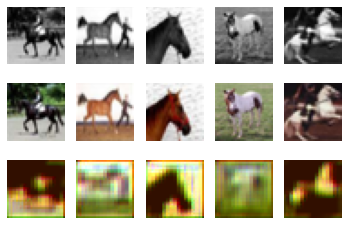

1 Train Losses: 0.033586374819278716
1 Validation Losses: 0.025303314812481402
Train Images Results


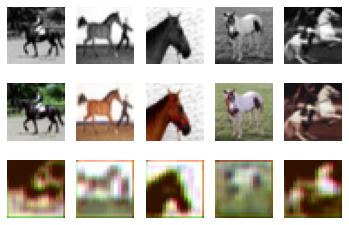

2 Train Losses: 0.021185928396880625
2 Validation Losses: 0.01891816146671772
Train Images Results


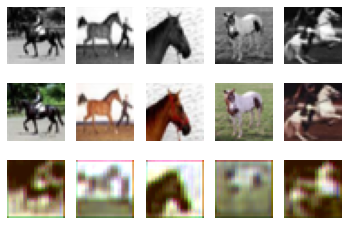

3 Train Losses: 0.017249141056090593
3 Validation Losses: 0.016334827803075314
Train Images Results


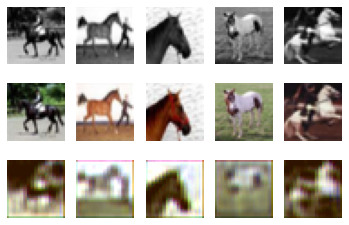

4 Train Losses: 0.015275840796530247
4 Validation Losses: 0.014851022604852914
Train Images Results


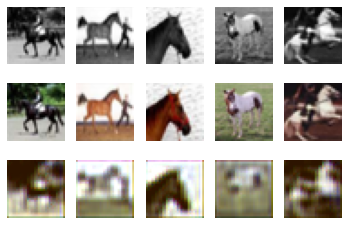

5 Train Losses: 0.01408386955037713
5 Validation Losses: 0.013921552523970603
Train Images Results


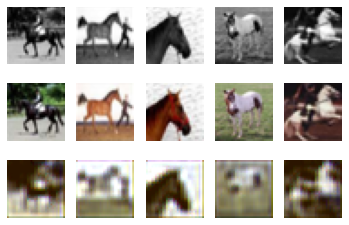

6 Train Losses: 0.013262409344315529
6 Validation Losses: 0.013183105178177357
Train Images Results


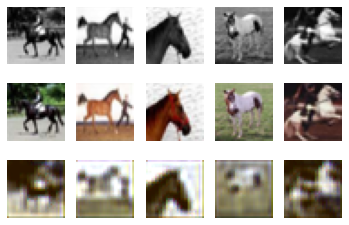

7 Train Losses: 0.01264473406597972
7 Validation Losses: 0.012548176757991313
Train Images Results


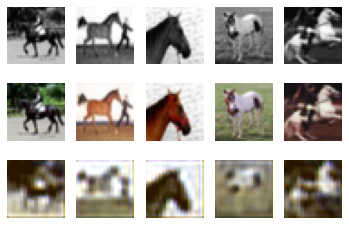

8 Train Losses: 0.012144303824752569
8 Validation Losses: 0.012015130184590817
Train Images Results


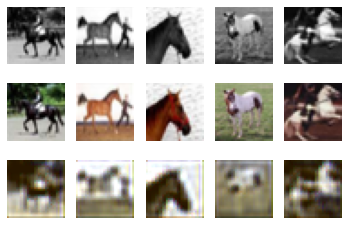

9 Train Losses: 0.01171470468863845
9 Validation Losses: 0.011606896016746759
Train Images Results


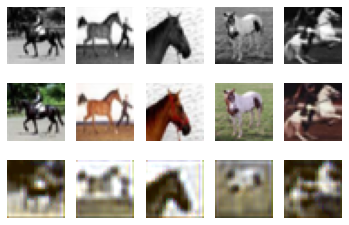

10 Train Losses: 0.01133653149008751
10 Validation Losses: 0.011273038759827613
Train Images Results


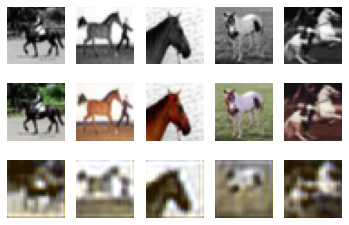

11 Train Losses: 0.011002844665199518
11 Validation Losses: 0.010954791028052569
Train Images Results


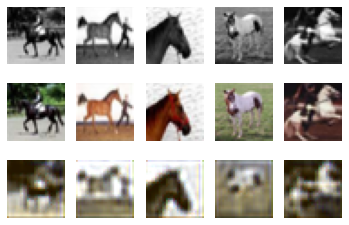

12 Train Losses: 0.010704802442342043
12 Validation Losses: 0.010668500512838363
Train Images Results


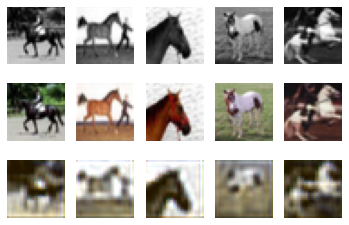

13 Train Losses: 0.010441730339080095
13 Validation Losses: 0.01041320813819766
Train Images Results


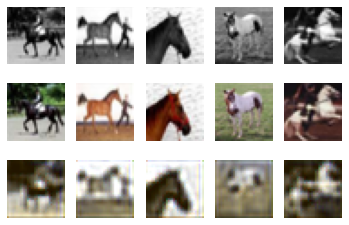

14 Train Losses: 0.010204135812819004
14 Validation Losses: 0.010189407039433718
Train Images Results


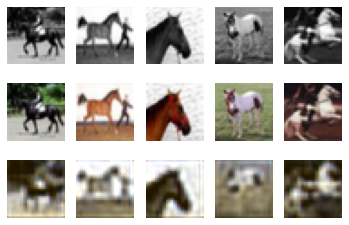

15 Train Losses: 0.00998945251107216
15 Validation Losses: 0.009975910466164351
Train Images Results


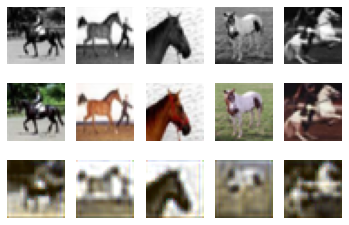

16 Train Losses: 0.009792871195822955
16 Validation Losses: 0.00978569034487009
Train Images Results


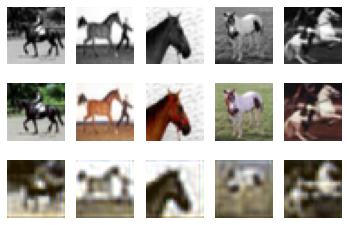

17 Train Losses: 0.00960967706516385
17 Validation Losses: 0.009601188451051712
Train Images Results


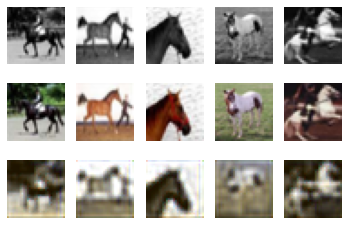

18 Train Losses: 0.009437525626271964
18 Validation Losses: 0.009437161684036254
Train Images Results


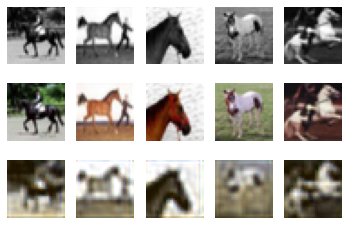

19 Train Losses: 0.009278872087597846
19 Validation Losses: 0.009286633785814047
Train Images Results


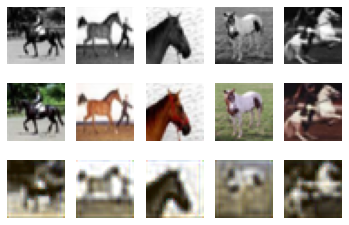

20 Train Losses: 0.009133062604814769
20 Validation Losses: 0.009133229870349169
Train Images Results


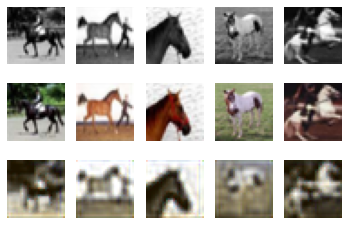

21 Train Losses: 0.008997361119836568
21 Validation Losses: 0.008988586906343698
Train Images Results


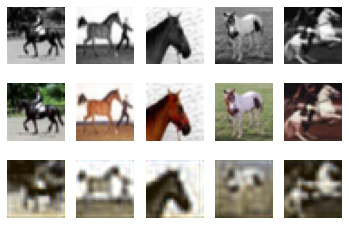

22 Train Losses: 0.00887296361848712
22 Validation Losses: 0.008860164321959019
Train Images Results


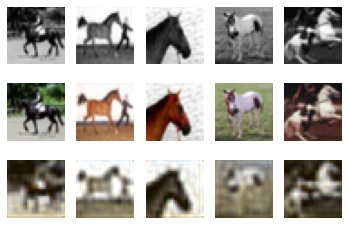

23 Train Losses: 0.008762608952820302
23 Validation Losses: 0.008744302112609148
Train Images Results


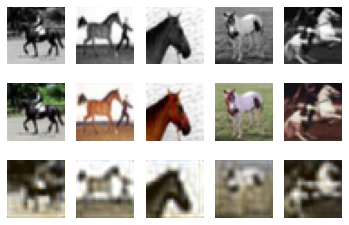

24 Train Losses: 0.008659737352281809
24 Validation Losses: 0.0086486728861928
Train Images Results


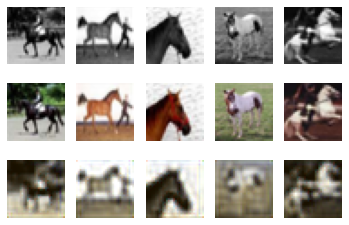

Final Validation Images Results


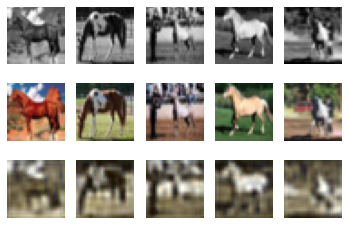

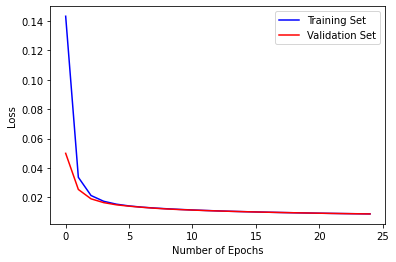

In [113]:
#Main training loop for CNN
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "RegressionCNN",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001, 
    "batch_size": 100,
    "epochs": 25,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}

args.update(args_dict)
cnn = train(args)

Answer: We are running total 25 epochs in given training.

### Part (c) [3 pt]
Re-train a couple of new models using a different number of training epochs. You may train each new models in a new code cell by copying and modifying the code from the last notebook cell. Comment on how the results (output images, training loss) change as we increase or decrease the number of epochs.

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...
0 Train Losses: 0.06953764975070953
0 Validation Losses: 0.024459348991513252
Train Images Results


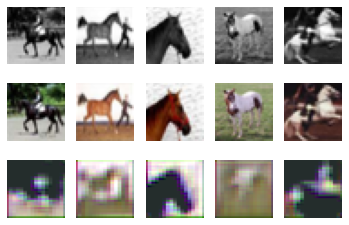

1 Train Losses: 0.019920867420732975
1 Validation Losses: 0.01764238830655813
Train Images Results


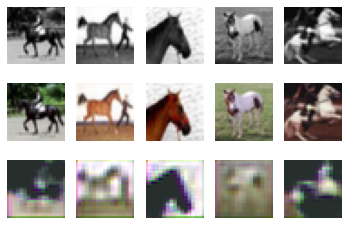

2 Train Losses: 0.016244478970766068
2 Validation Losses: 0.015162240061908961
Train Images Results


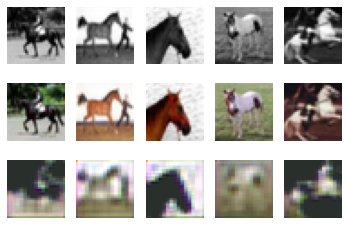

3 Train Losses: 0.014339138194918633
3 Validation Losses: 0.01355485012754798
Train Images Results


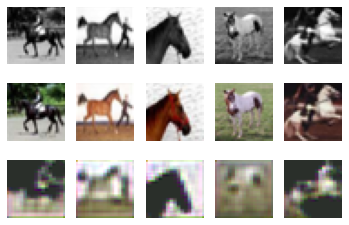

4 Train Losses: 0.013098586834967136
4 Validation Losses: 0.01252827038988471
Train Images Results


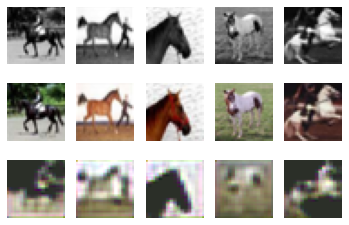

5 Train Losses: 0.012226615976542234
5 Validation Losses: 0.011840653885155917
Train Images Results


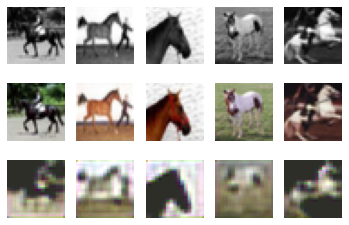

6 Train Losses: 0.011611785143613815
6 Validation Losses: 0.011307330615818501
Train Images Results


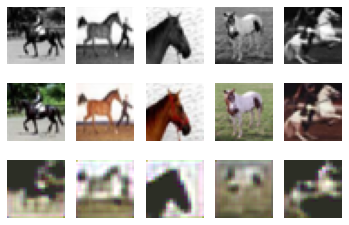

7 Train Losses: 0.011137673780322075
7 Validation Losses: 0.010839682817459107
Train Images Results


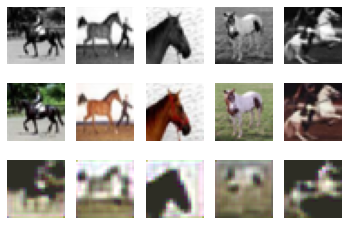

8 Train Losses: 0.010771768987178803
8 Validation Losses: 0.010477379895746708
Train Images Results


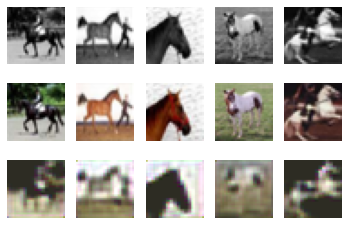

9 Train Losses: 0.010477456972002983
9 Validation Losses: 0.010187617875635624
Train Images Results


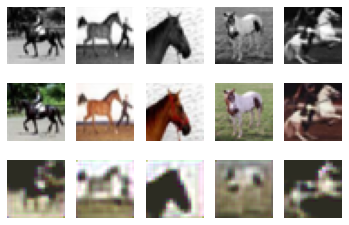

10 Train Losses: 0.01020981365814805
10 Validation Losses: 0.009909104090183973
Train Images Results


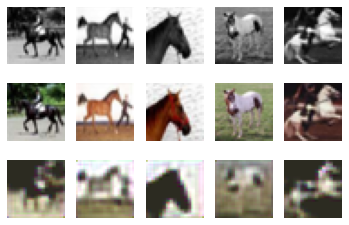

11 Train Losses: 0.009980652537196875
11 Validation Losses: 0.009691576939076185
Train Images Results


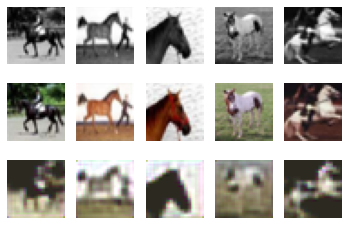

12 Train Losses: 0.009771920237690211
12 Validation Losses: 0.009501101449131966
Train Images Results


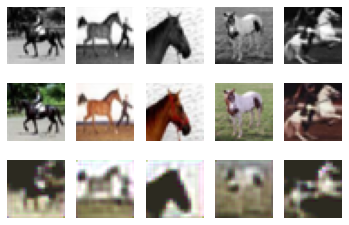

13 Train Losses: 0.009582120832055807
13 Validation Losses: 0.00932502094656229
Train Images Results


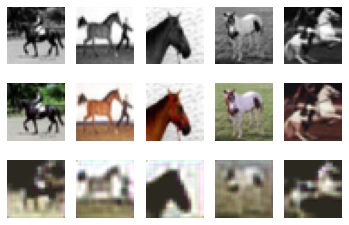

14 Train Losses: 0.009413461815565825
14 Validation Losses: 0.00916721997782588
Train Images Results


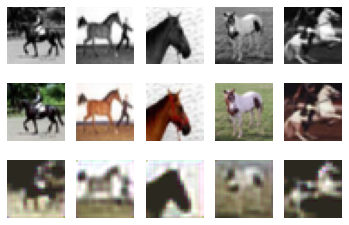

15 Train Losses: 0.009255977738648653
15 Validation Losses: 0.00901728356257081
Train Images Results


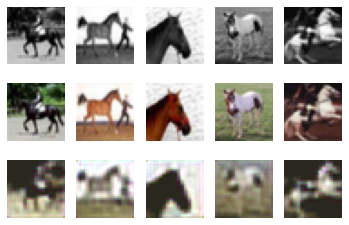

16 Train Losses: 0.009106932263821364
16 Validation Losses: 0.008897947520017624
Train Images Results


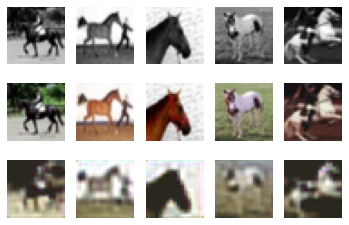

17 Train Losses: 0.008970019314438105
17 Validation Losses: 0.008768390025943517
Train Images Results


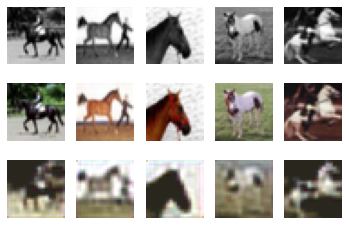

18 Train Losses: 0.008841069173067808
18 Validation Losses: 0.008650734275579452
Train Images Results


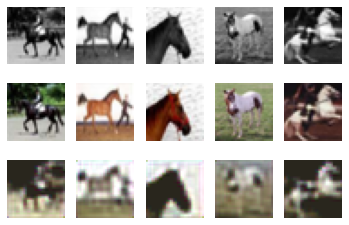

19 Train Losses: 0.008722551502287387
19 Validation Losses: 0.00854355851188302
Train Images Results


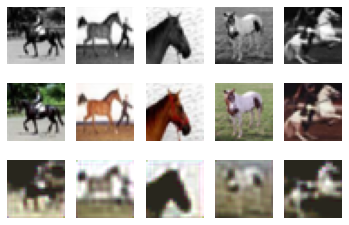

20 Train Losses: 0.00861165465787053
20 Validation Losses: 0.008450359664857387
Train Images Results


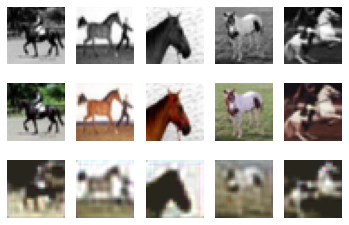

21 Train Losses: 0.00850759812630713
21 Validation Losses: 0.008357094740495086
Train Images Results


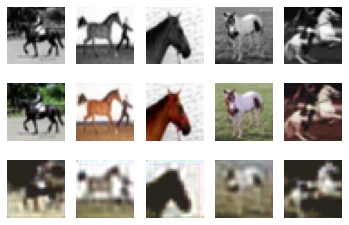

22 Train Losses: 0.008405770119279623
22 Validation Losses: 0.00827022730372846
Train Images Results


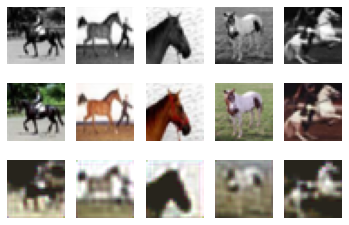

23 Train Losses: 0.008309564692899585
23 Validation Losses: 0.008190373657271266
Train Images Results


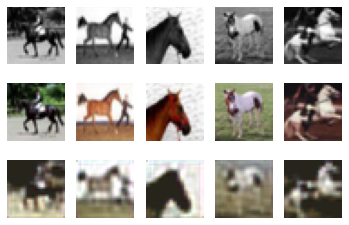

24 Train Losses: 0.008219023970887064
24 Validation Losses: 0.008109989343211055
Train Images Results


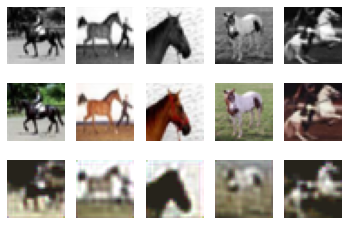

25 Train Losses: 0.008132699579000473
25 Validation Losses: 0.008034302480518818
Train Images Results


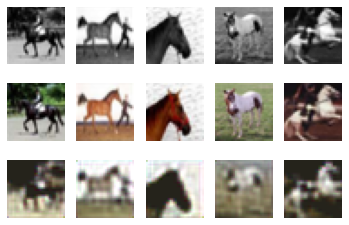

26 Train Losses: 0.008051239121705293
26 Validation Losses: 0.007957963552325965
Train Images Results


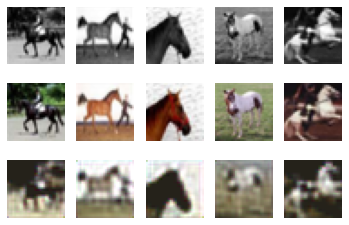

27 Train Losses: 0.007971511445939541
27 Validation Losses: 0.007893886556848884
Train Images Results


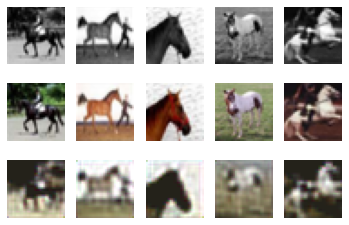

28 Train Losses: 0.007894473299384117
28 Validation Losses: 0.007821465190500022
Train Images Results


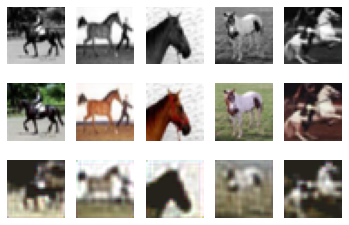

29 Train Losses: 0.007816357286646963
29 Validation Losses: 0.007754072872921824
Train Images Results


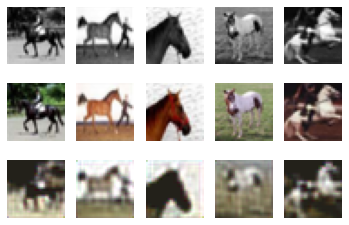

Final Validation Images Results


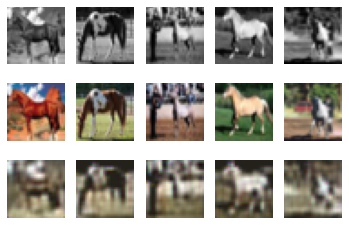

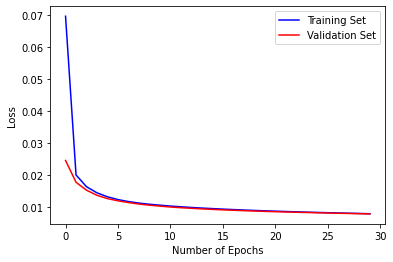

In [114]:
#Main training loop for CNN
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "RegressionCNN",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001, 
    "batch_size": 100,
    "epochs": 30,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}

args.update(args_dict)
cnn = train(args)

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...


0 Train Losses: 0.2646707820892334
0 Validation Losses: 0.09791196808218956
Train Images Results


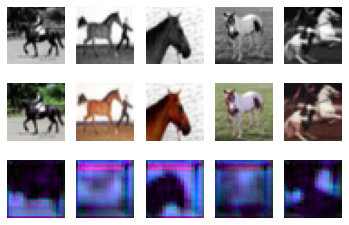

1 Train Losses: 0.048323592878878115
1 Validation Losses: 0.0262119323015213
Train Images Results


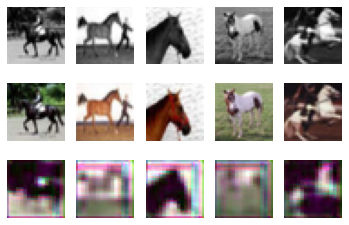

2 Train Losses: 0.02058014936745167
2 Validation Losses: 0.017753459326922894
Train Images Results


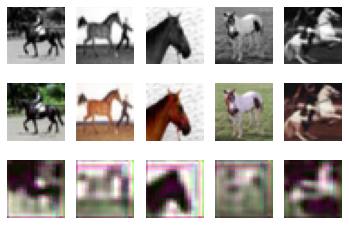

3 Train Losses: 0.01625818096101284
3 Validation Losses: 0.015204715821892024
Train Images Results


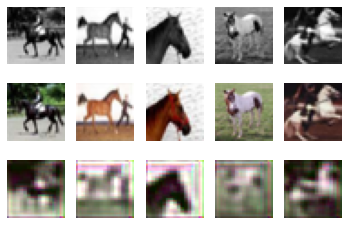

4 Train Losses: 0.014517883863300085
4 Validation Losses: 0.014025515224784613
Train Images Results


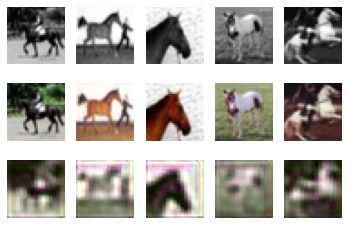

5 Train Losses: 0.013587909881025553
5 Validation Losses: 0.013215103652328253
Train Images Results


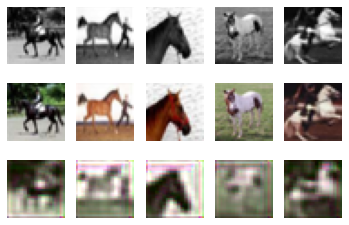

6 Train Losses: 0.012938794903457165
6 Validation Losses: 0.01263685068115592
Train Images Results


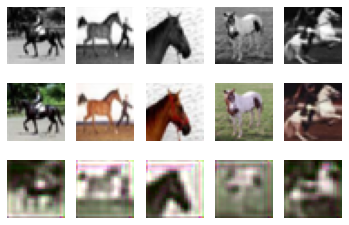

7 Train Losses: 0.012436324246227742
7 Validation Losses: 0.012174632493406534
Train Images Results


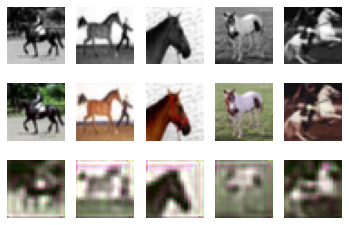

8 Train Losses: 0.012023878768086433
8 Validation Losses: 0.011796159576624632
Train Images Results


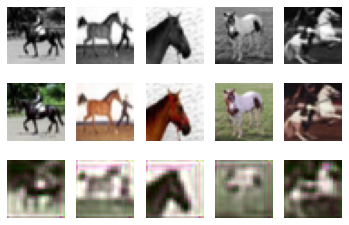

9 Train Losses: 0.011675803512334824
9 Validation Losses: 0.011474207136780023
Train Images Results


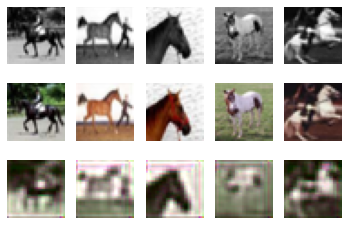

10 Train Losses: 0.0113764763250947
10 Validation Losses: 0.011209899466484785
Train Images Results


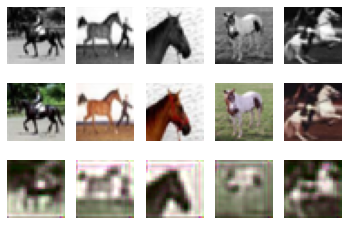

11 Train Losses: 0.011119430381804705
11 Validation Losses: 0.010993779823184013
Train Images Results


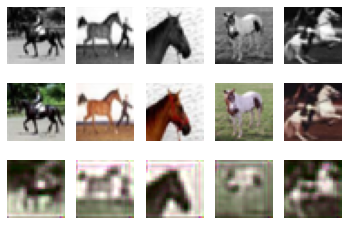

12 Train Losses: 0.010897069796919822
12 Validation Losses: 0.010806205589324236
Train Images Results


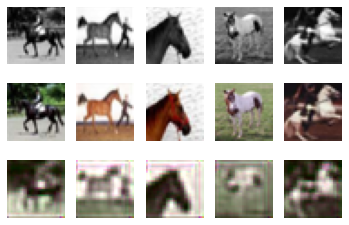

13 Train Losses: 0.010701379124075174
13 Validation Losses: 0.01063223509117961
Train Images Results


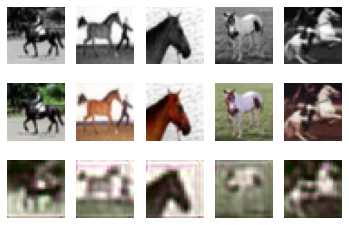

14 Train Losses: 0.010528695080429315
14 Validation Losses: 0.010488654114305973
Train Images Results


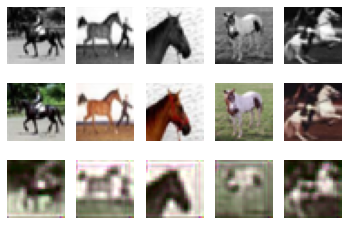

15 Train Losses: 0.010374387074261904
15 Validation Losses: 0.010345346946269273
Train Images Results


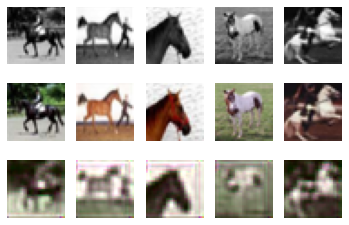

16 Train Losses: 0.010236378032714129
16 Validation Losses: 0.010218863654881716
Train Images Results


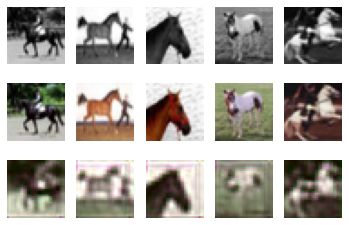

17 Train Losses: 0.010111655220389365
17 Validation Losses: 0.01009598933160305
Train Images Results


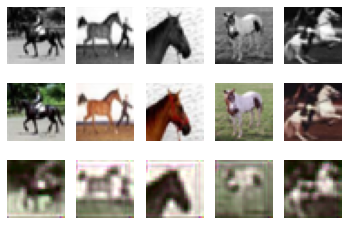

18 Train Losses: 0.009997983574867248
18 Validation Losses: 0.009981963876634836
Train Images Results


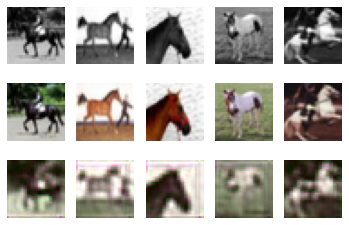

19 Train Losses: 0.009893322046846151
19 Validation Losses: 0.009878622367978096
Train Images Results


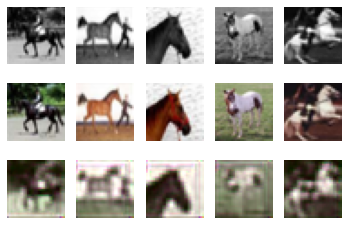

20 Train Losses: 0.009795643202960492
20 Validation Losses: 0.009781796298921109
Train Images Results


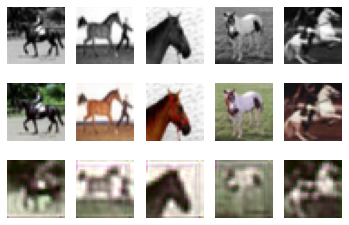

21 Train Losses: 0.009704702254384755
21 Validation Losses: 0.009695265162736177
Train Images Results


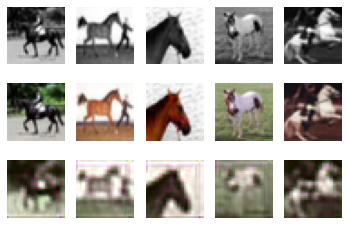

22 Train Losses: 0.009618377350270747
22 Validation Losses: 0.009604933205991983
Train Images Results


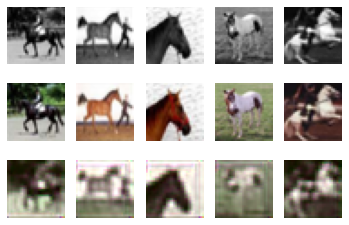

23 Train Losses: 0.009537609592080117
23 Validation Losses: 0.009526354353874921
Train Images Results


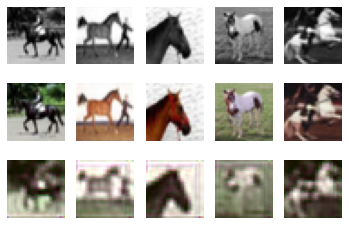

24 Train Losses: 0.009460395257920027
24 Validation Losses: 0.009447651449590921
Train Images Results


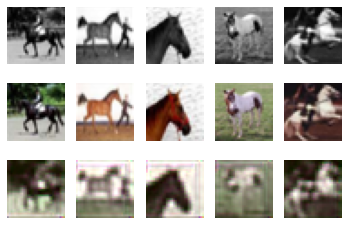

25 Train Losses: 0.009387172143906355
25 Validation Losses: 0.009378782287240029
Train Images Results


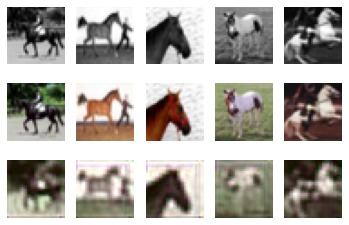

26 Train Losses: 0.009317332580685615
26 Validation Losses: 0.009315586742013693
Train Images Results


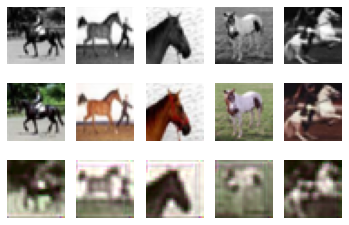

27 Train Losses: 0.009250709172338247
27 Validation Losses: 0.00924072191119194
Train Images Results


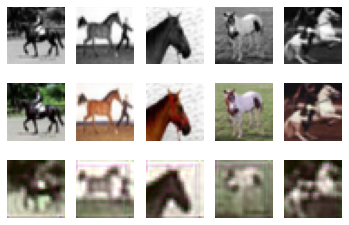

28 Train Losses: 0.009186636973172426
28 Validation Losses: 0.009176796488463878
Train Images Results


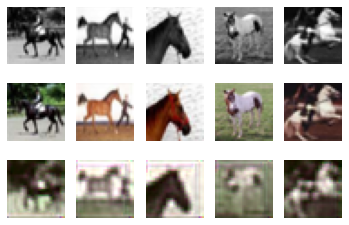

29 Train Losses: 0.009124229792505503
29 Validation Losses: 0.009112240746617317
Train Images Results


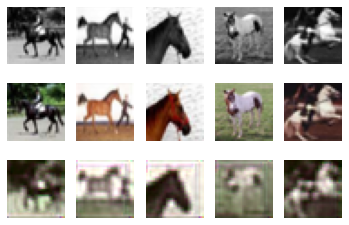

30 Train Losses: 0.009063401520252227
30 Validation Losses: 0.009047777112573385
Train Images Results


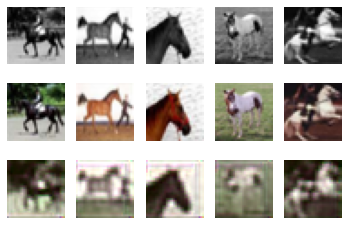

31 Train Losses: 0.009003913514316082
31 Validation Losses: 0.008987719751894474
Train Images Results


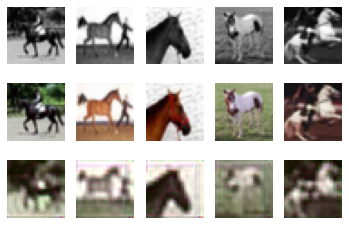

32 Train Losses: 0.008946145568042994
32 Validation Losses: 0.00892962496727705
Train Images Results


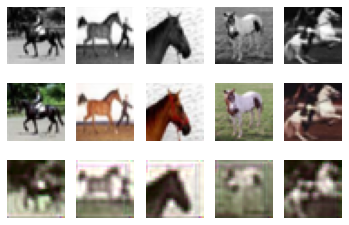

33 Train Losses: 0.00888917326927185
33 Validation Losses: 0.008876209240406751
Train Images Results


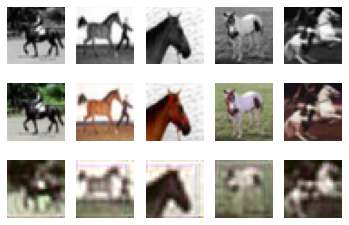

34 Train Losses: 0.008833384849131107
34 Validation Losses: 0.008814684953540564
Train Images Results


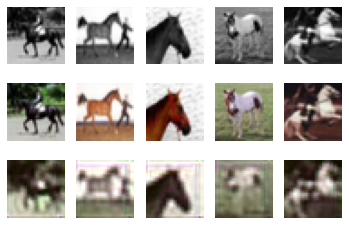

35 Train Losses: 0.008777684718370437
35 Validation Losses: 0.008758783619850875
Train Images Results


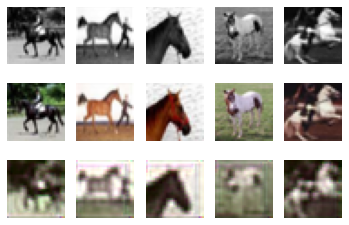

36 Train Losses: 0.008722268007695676
36 Validation Losses: 0.008704224321991205
Train Images Results


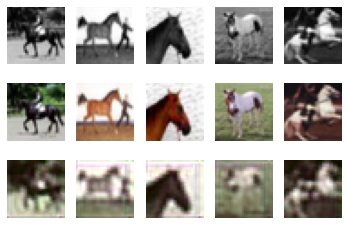

37 Train Losses: 0.008666855357587338
37 Validation Losses: 0.008652254659682512
Train Images Results


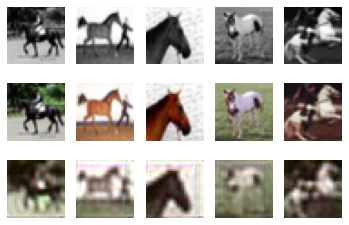

38 Train Losses: 0.008611050788313151
38 Validation Losses: 0.008601541351526975
Train Images Results


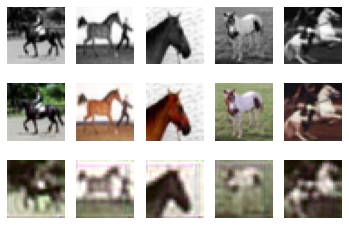

39 Train Losses: 0.00855519661679864
39 Validation Losses: 0.008554510679095984
Train Images Results


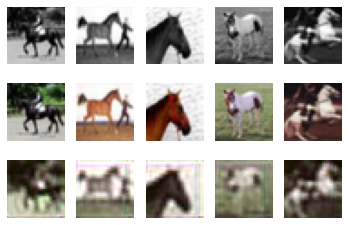

40 Train Losses: 0.00849838824942708
40 Validation Losses: 0.008501183288171888
Train Images Results


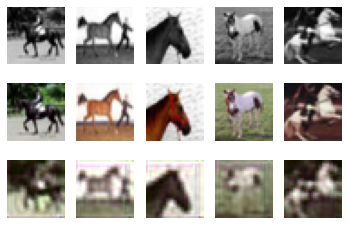

41 Train Losses: 0.00844006328843534
41 Validation Losses: 0.008457121578976512
Train Images Results


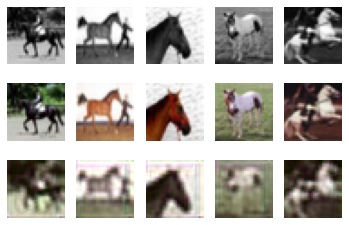

42 Train Losses: 0.008380630435422063
42 Validation Losses: 0.00841130050830543
Train Images Results


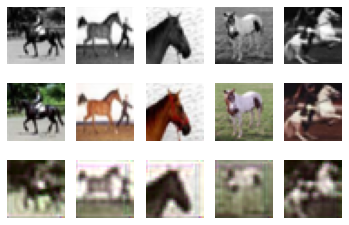

43 Train Losses: 0.00831950037740171
43 Validation Losses: 0.008363669877871871
Train Images Results


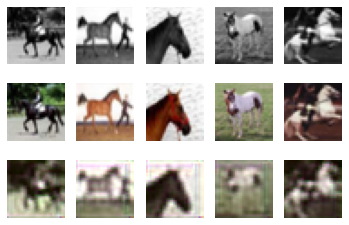

44 Train Losses: 0.00825657949782908
44 Validation Losses: 0.008323333784937858
Train Images Results


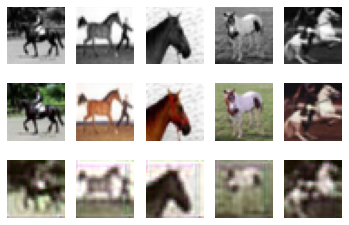

45 Train Losses: 0.008191337045282125
45 Validation Losses: 0.008276593126356601
Train Images Results


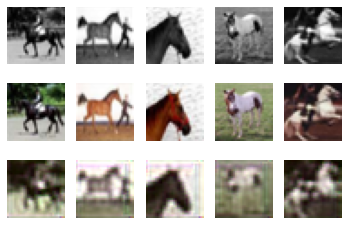

46 Train Losses: 0.008123787483200431
46 Validation Losses: 0.008238291600719094
Train Images Results


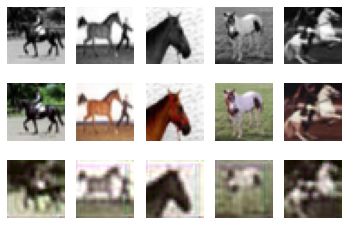

47 Train Losses: 0.008053911114111544
47 Validation Losses: 0.008185383724048733
Train Images Results


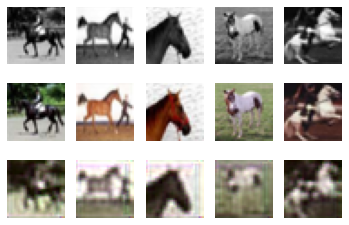

48 Train Losses: 0.007980324868112803
48 Validation Losses: 0.008138724649325014
Train Images Results


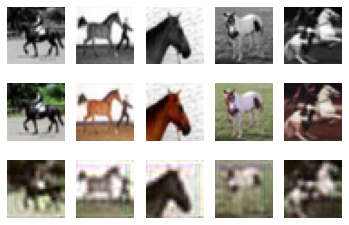

49 Train Losses: 0.007904133480042218
49 Validation Losses: 0.008088515559211373
Train Images Results


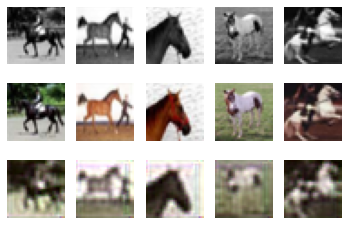

Final Validation Images Results


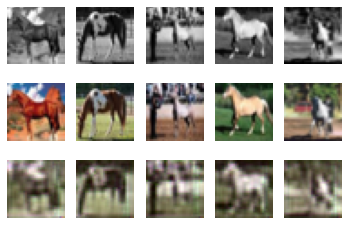

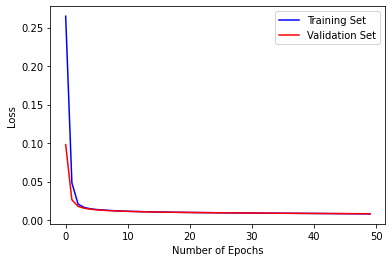

In [115]:
#Main training loop for CNN
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "RegressionCNN",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001, 
    "batch_size": 100,
    "epochs": 50,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}

args.update(args_dict)
cnn = train(args)

Answer: 
* We have tries 2 new models with epoch numbers 30 and 50, training loss continuously decreases with increased number of epochs we can see from results.
* But visually looking at images we can say that there isn't much difference between output images after increasing number of epochs.

## Part 3. Skip Connections [8 pt]
A skip connection in a neural network is a connection which skips one or more layer and connects to a later layer. We will introduce skip connections.

### Part (a) [4 pt]
Add a skip connection from the first layer to the last, second layer to the second last, etc.
That is, the final convolution should have both the output of the previous layer and the initial greyscale input as input. This type of skip-connection is introduced by [3], and is called a "UNet". Following the CNN class that you have completed, complete the __init__ and forward methods of the UNet class.
Hint: You will need to use the function torch.cat.

In [116]:
#complete the code
def crop_tensor(target_tensor, tensor):
    target_size = target_tensor.size()[2]
    tensor_size = tensor.size()[2]
    delta = tensor_size - target_size
    delta = delta // 2

    return tensor[:, :, delta:tensor_size- delta, delta:tensor_size-delta]

class UNet(nn.Module):
    def __init__(self, kernel, num_filters, num_colours=3, num_in_channels=1):
        super().__init__()

        # Useful parameters
        stride = 2
        padding = kernel // 2
        output_padding = 1

        ############### YOUR CODE GOES HERE ############### 
        ###################################################
        self.downconv1 = nn.Sequential(
            nn.Conv2d(num_in_channels, num_filters, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters),
            nn.ReLU(),)
        self.downconv2 = nn.Sequential(
            nn.Conv2d(num_filters, num_filters*2, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters*2),
            nn.ReLU(),)

        self.rfconv = nn.Sequential(
            nn.Conv2d(num_filters*2, num_filters*2, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters*2),
            nn.ReLU(),)
        
        self.conv_T1 = nn.ConvTranspose2d(num_filters*2, num_filters, kernel_size=kernel,stride = 2, padding= padding,output_padding = 1)
        self.conv_T2 = nn.ConvTranspose2d(num_filters, num_filters, kernel_size=kernel,stride = 2, padding= padding,output_padding = 1)


        self.upconv1 = nn.Sequential(
            nn.Conv2d(num_filters*2, num_filters, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters),
            nn.ReLU(),)
        self.upconv2 = nn.Sequential(
            nn.Conv2d(num_filters, 3, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(3),
            nn.ReLU(),)
        self.finalconv = nn.ConvTranspose2d(4, 3, kernel_size=kernel,stride = 1, padding = padding)
        self.maxpool = nn.MaxPool2d(2)

    def forward(self, x):
        ############### YOUR CODE GOES HERE ###############
        ###################################################
        out1 = self.downconv1(x)
        out2 = self.maxpool(out1)

        out3 = self.downconv2(out2)
        out4 = self.maxpool(out3)

        out5 = self.rfconv(out4)
        out = self.conv_T1(out5)

        out = self.upconv1(torch.cat([out,out2],1))
        out = self.conv_T2(out)

        out = self.upconv2(out)

        out = self.finalconv(torch.cat([out,x],1))
        return out

In [117]:
model = UNet(3,32)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)
summary(model,(1,32,32))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 32, 32, 32]             320
       BatchNorm2d-2           [-1, 32, 32, 32]              64
              ReLU-3           [-1, 32, 32, 32]               0
         MaxPool2d-4           [-1, 32, 16, 16]               0
            Conv2d-5           [-1, 64, 16, 16]          18,496
       BatchNorm2d-6           [-1, 64, 16, 16]             128
              ReLU-7           [-1, 64, 16, 16]               0
         MaxPool2d-8             [-1, 64, 8, 8]               0
            Conv2d-9             [-1, 64, 8, 8]          36,928
      BatchNorm2d-10             [-1, 64, 8, 8]             128
             ReLU-11             [-1, 64, 8, 8]               0
  ConvTranspose2d-12           [-1, 32, 16, 16]          18,464
           Conv2d-13           [-1, 32, 16, 16]          18,464
      BatchNorm2d-14           [-1, 32,

### Part (b) [2 pt]
Train the "UNet" model for the same amount of epochs as the previous CNN and plot the training curve using a batch size of 100. How does the result compare to the previous model? Did skip connections improve the validation loss and accuracy? Did the skip connections improve the output qualitatively? How? Give at least two reasons why skip connections might improve the performance of our CNN models.

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...


0 Train Losses: 0.24609878033399582
0 Validation Losses: 0.04174692779779434
Train Images Results


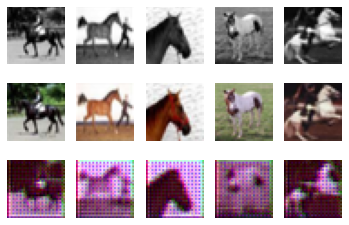

1 Train Losses: 0.021176321357488634
1 Validation Losses: 0.01500696036964655
Train Images Results


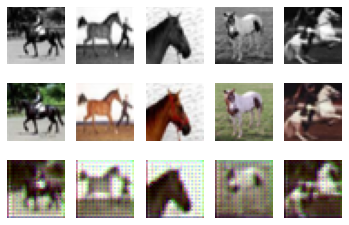

2 Train Losses: 0.013231678772717715
2 Validation Losses: 0.0117921550758183
Train Images Results


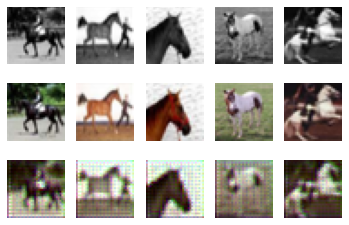

3 Train Losses: 0.010887197181582452
3 Validation Losses: 0.00994255654513836
Train Images Results


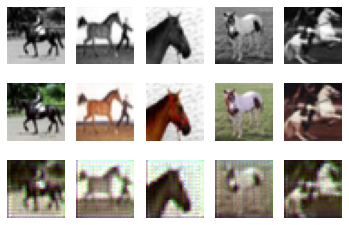

4 Train Losses: 0.009451409801840782
4 Validation Losses: 0.008771330490708351
Train Images Results


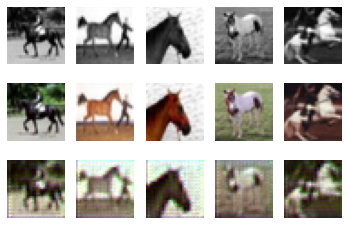

5 Train Losses: 0.008467680420726537
5 Validation Losses: 0.007986522139981389
Train Images Results


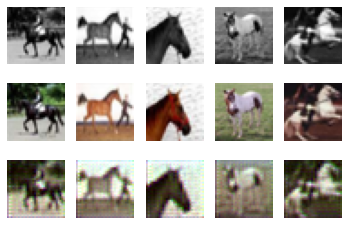

6 Train Losses: 0.007785489438101649
6 Validation Losses: 0.007421471830457449
Train Images Results


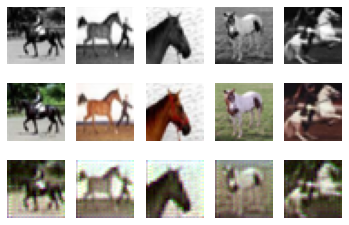

7 Train Losses: 0.007270804531872272
7 Validation Losses: 0.006988893495872617
Train Images Results


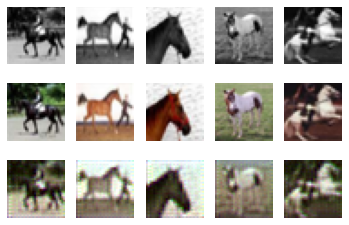

8 Train Losses: 0.0068720174487680195
8 Validation Losses: 0.00664450628682971
Train Images Results


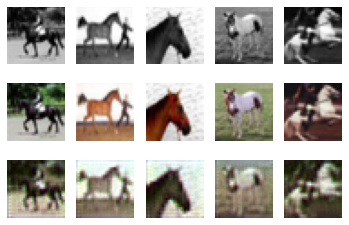

9 Train Losses: 0.00655027330853045
9 Validation Losses: 0.006364436261355877
Train Images Results


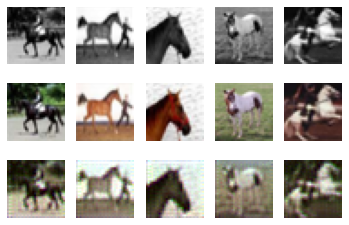

10 Train Losses: 0.006281656697392463
10 Validation Losses: 0.006116900779306889
Train Images Results


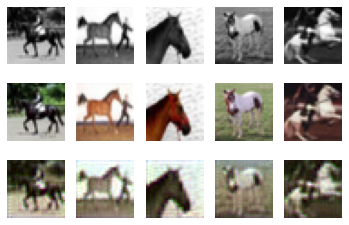

11 Train Losses: 0.006050919499248266
11 Validation Losses: 0.0058915502391755584
Train Images Results


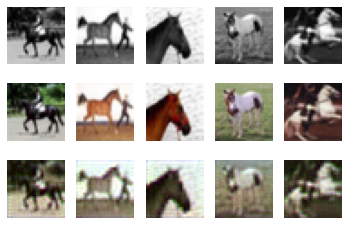

12 Train Losses: 0.005849058125168085
12 Validation Losses: 0.005698780808597803
Train Images Results


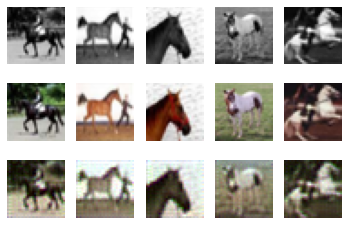

13 Train Losses: 0.0056694904807955025
13 Validation Losses: 0.005536615289747715
Train Images Results


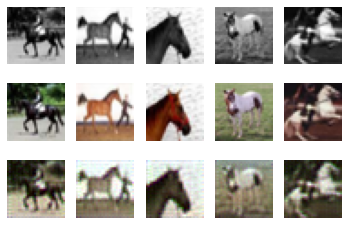

14 Train Losses: 0.0055167838744819165
14 Validation Losses: 0.005418813740834594
Train Images Results


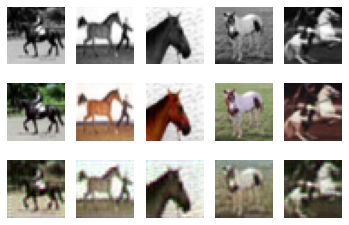

15 Train Losses: 0.005402000835165382
15 Validation Losses: 0.005319364555180073
Train Images Results


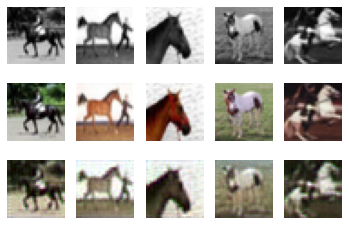

16 Train Losses: 0.005307186571881175
16 Validation Losses: 0.005187789723277092
Train Images Results


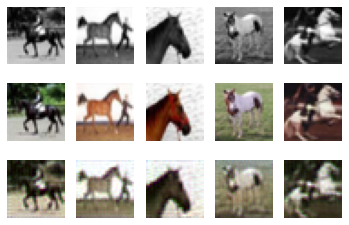

17 Train Losses: 0.005169883016496897
17 Validation Losses: 0.005081402743235231
Train Images Results


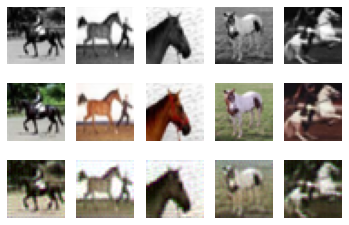

18 Train Losses: 0.005050097219645977
18 Validation Losses: 0.004996086563915014
Train Images Results


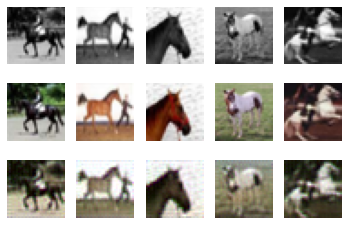

19 Train Losses: 0.0049533126410096886
19 Validation Losses: 0.004929668689146638
Train Images Results


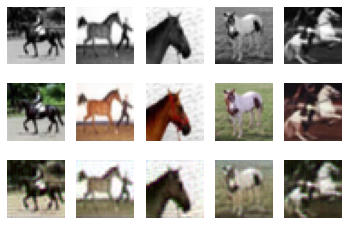

20 Train Losses: 0.00486496745608747
20 Validation Losses: 0.004875516518950462
Train Images Results


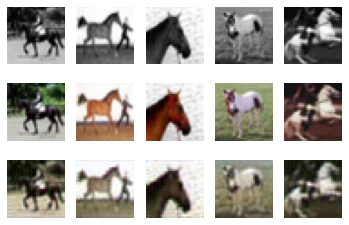

21 Train Losses: 0.004784574313089251
21 Validation Losses: 0.0048157034907490015
Train Images Results


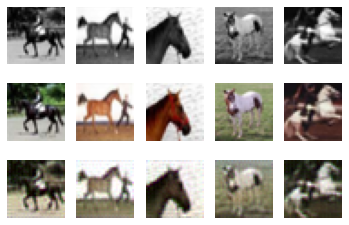

22 Train Losses: 0.004710358213633299
22 Validation Losses: 0.0047627441119402645
Train Images Results


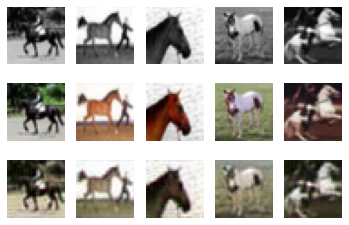

23 Train Losses: 0.004641524041071534
23 Validation Losses: 0.004709748551249504
Train Images Results


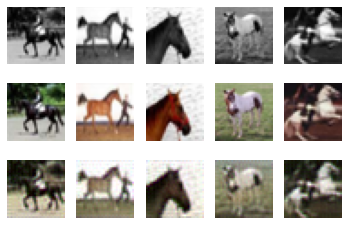

24 Train Losses: 0.004577033100649715
24 Validation Losses: 0.004663974978029728
Train Images Results


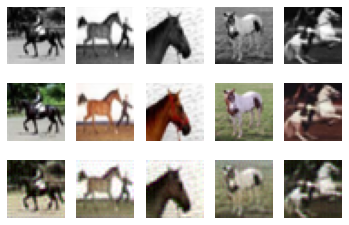

Final Validation Images Results


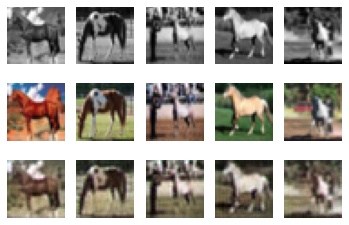

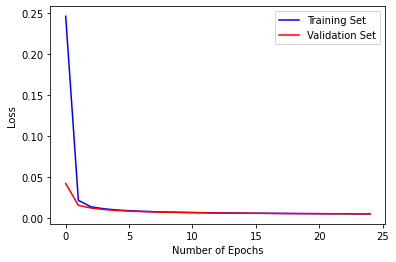

In [118]:
# Main training loop for UNet
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "UNet",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001, 
    "batch_size": 100,
    "epochs": 25,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}
args.update(args_dict)
cnn = train(args)

Compared to previous model UNet performs better as we can see from results.
Unet converges quickly in lee numbers of epochs then RegressionCNN model.
Skip connection decreased the value of validation losses.
Also Unet improved output quality.

-  since we are concating initial features(Skip Connection) to the decoder part. So we are getting better results, because of information transfer.
-  Skip connection can prevent complex model from going into vanishing gradients.

### Part (c) [2 pt]
Re-train a few more "UNet" models using different mini batch sizes with a fixed number of epochs. Describe the effect of batch sizes on the training/validation loss, and the final image output.

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...


0 Train Losses: 0.2712745614349842
0 Validation Losses: 0.16256855800747871
Train Images Results


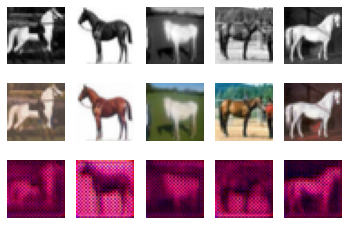

1 Train Losses: 0.08896473497152328
1 Validation Losses: 0.06297387182712555
Train Images Results


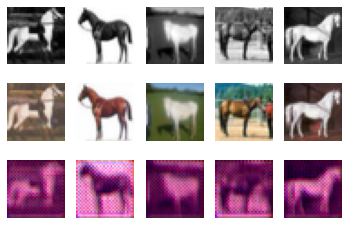

2 Train Losses: 0.03674525720998645
2 Validation Losses: 0.026970581617206335
Train Images Results


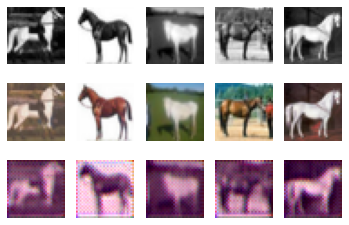

3 Train Losses: 0.01985453674569726
3 Validation Losses: 0.016851861029863358
Train Images Results


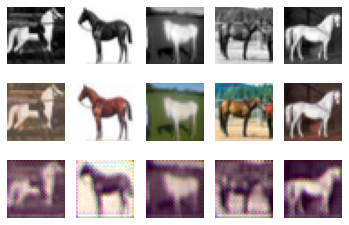

4 Train Losses: 0.01421027178876102
4 Validation Losses: 0.013229453703388572
Train Images Results


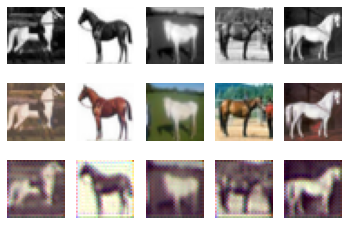

5 Train Losses: 0.01215915665961802
5 Validation Losses: 0.011624425183981657
Train Images Results


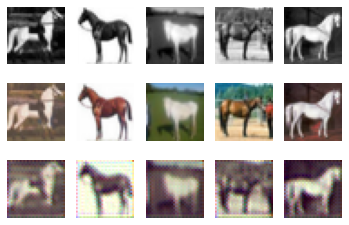

6 Train Losses: 0.011111021647229791
6 Validation Losses: 0.010793718975037336
Train Images Results


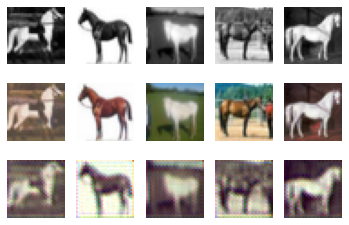

7 Train Losses: 0.01039643627591431
7 Validation Losses: 0.010179226752370596
Train Images Results


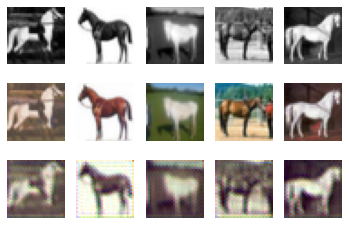

8 Train Losses: 0.009807154955342411
8 Validation Losses: 0.009638488991186023
Train Images Results


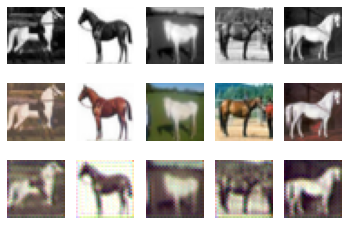

9 Train Losses: 0.009303227951750159
9 Validation Losses: 0.009163326118141413
Train Images Results


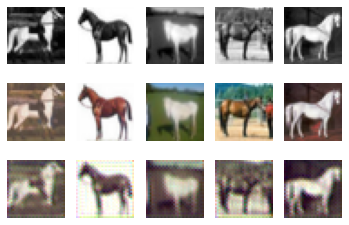

10 Train Losses: 0.008869138872250914
10 Validation Losses: 0.008744989754632115
Train Images Results


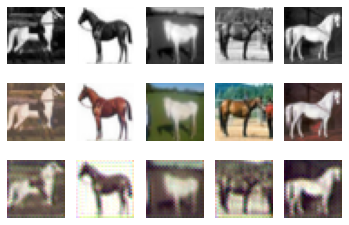

11 Train Losses: 0.008489303663372994
11 Validation Losses: 0.008380877552554011
Train Images Results


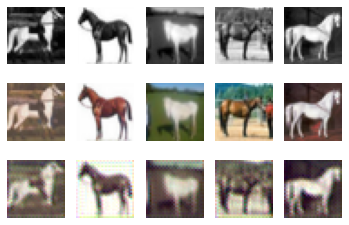

12 Train Losses: 0.008154045999981463
12 Validation Losses: 0.008060578489676118
Train Images Results


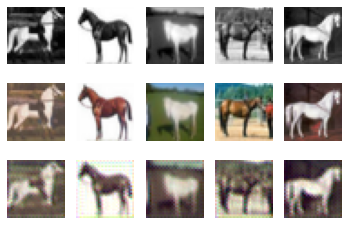

13 Train Losses: 0.00785295816604048
13 Validation Losses: 0.007775880396366119
Train Images Results


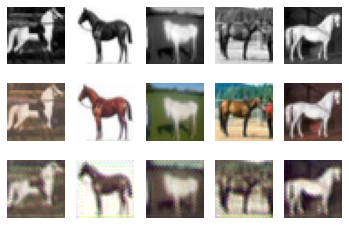

14 Train Losses: 0.007579688215628266
14 Validation Losses: 0.007520253653638065
Train Images Results


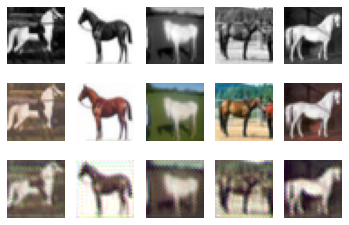

15 Train Losses: 0.007332219672389328
15 Validation Losses: 0.007289736880920827
Train Images Results


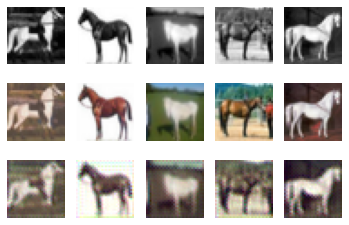

16 Train Losses: 0.007110119354911149
16 Validation Losses: 0.007088515325449407
Train Images Results


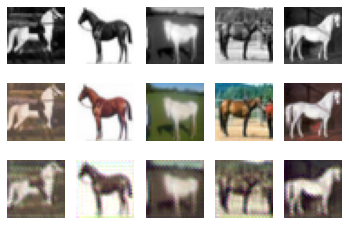

17 Train Losses: 0.006906920624896884
17 Validation Losses: 0.00691741518676281
Train Images Results


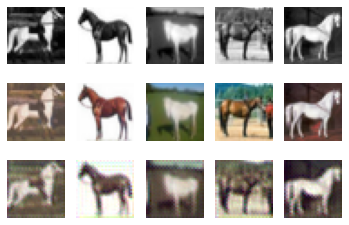

18 Train Losses: 0.00672470461577177
18 Validation Losses: 0.006767710205167532
Train Images Results


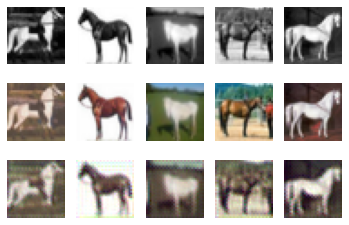

19 Train Losses: 0.006562356860376895
19 Validation Losses: 0.006629290175624192
Train Images Results


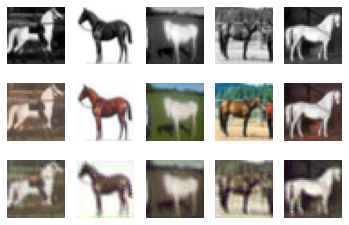

20 Train Losses: 0.006416200287640094
20 Validation Losses: 0.006508383434265852
Train Images Results


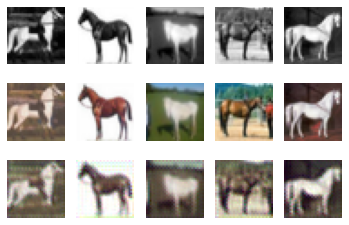

21 Train Losses: 0.006281905411742628
21 Validation Losses: 0.006404082174412906
Train Images Results


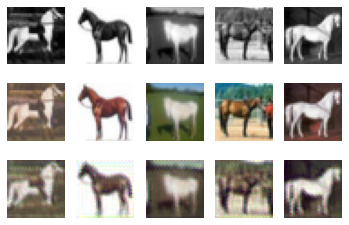

22 Train Losses: 0.0061573266284540296
22 Validation Losses: 0.006309627206064761
Train Images Results


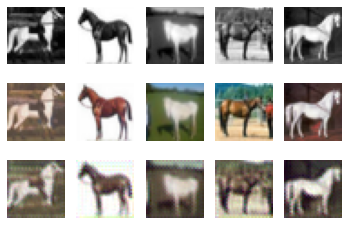

23 Train Losses: 0.006042526662349701
23 Validation Losses: 0.006214672117494047
Train Images Results


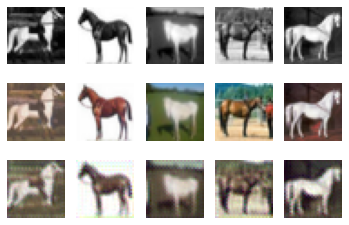

24 Train Losses: 0.005937989498488605
24 Validation Losses: 0.006122047198005021
Train Images Results


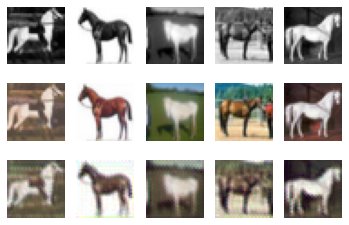

Final Validation Images Results


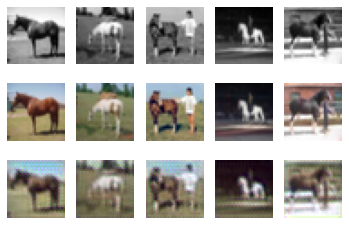

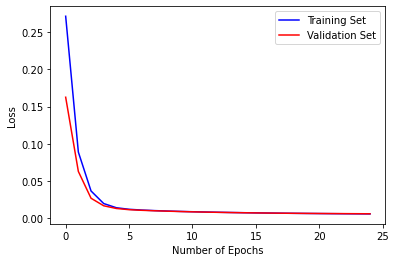

In [119]:
# complete the code

# Main training loop for UNet
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "UNet",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001, 
    "batch_size": 256,
    "epochs": 25,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}
args.update(args_dict)
cnn = train(args)

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...


0 Train Losses: 0.06997388845701126
0 Validation Losses: 0.013779428030829877
Train Images Results


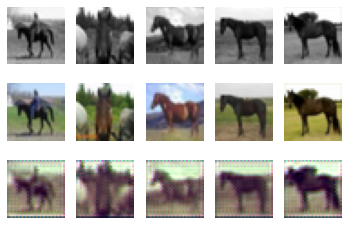

1 Train Losses: 0.011467640246650215
1 Validation Losses: 0.009581997495843098
Train Images Results


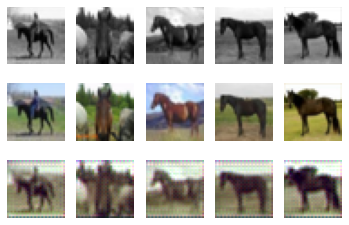

2 Train Losses: 0.008594132977638655
2 Validation Losses: 0.008105229120701551
Train Images Results


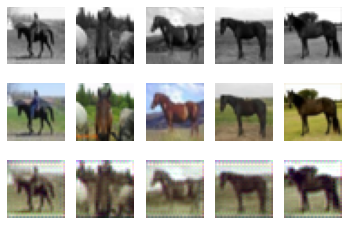

3 Train Losses: 0.007311517283747531
3 Validation Losses: 0.007311312700039707
Train Images Results


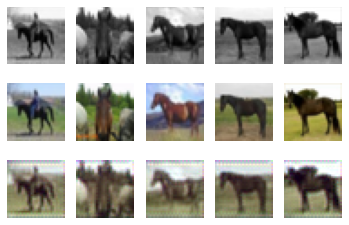

4 Train Losses: 0.006505762499751179
4 Validation Losses: 0.0062779747968306765
Train Images Results


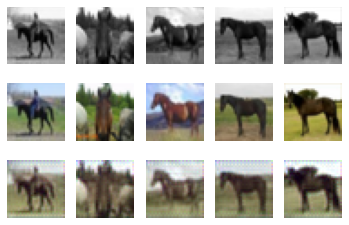

5 Train Losses: 0.00572389378479332
5 Validation Losses: 0.005608871681033634
Train Images Results


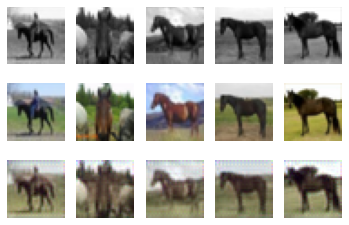

6 Train Losses: 0.005311931981734789
6 Validation Losses: 0.005265224986942485
Train Images Results


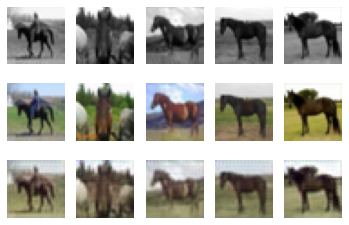

7 Train Losses: 0.005016374449204108
7 Validation Losses: 0.0050307795172557235
Train Images Results


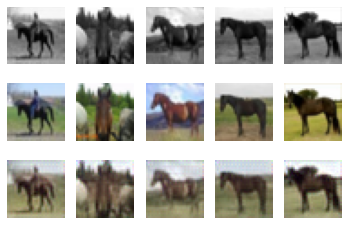

8 Train Losses: 0.0047909321936713475
8 Validation Losses: 0.004827459619264118
Train Images Results


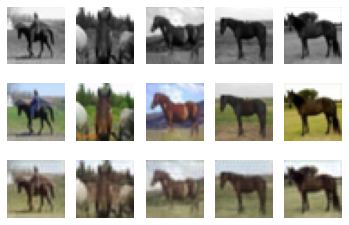

9 Train Losses: 0.004608815887373439
9 Validation Losses: 0.004694506947998889
Train Images Results


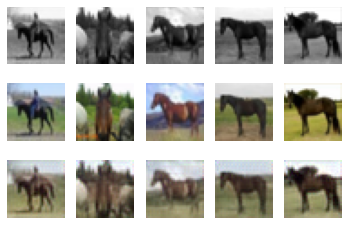

10 Train Losses: 0.004458426767782231
10 Validation Losses: 0.004576180916046724
Train Images Results


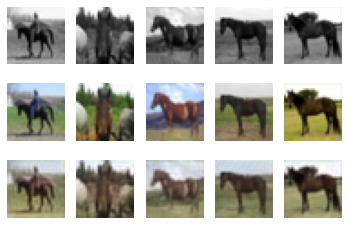

11 Train Losses: 0.004329790610369224
11 Validation Losses: 0.004480451381823514
Train Images Results


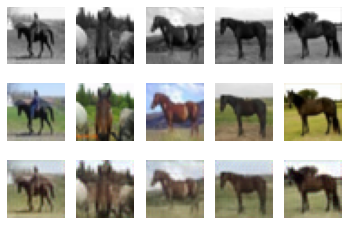

12 Train Losses: 0.004218351568991117
12 Validation Losses: 0.004405332780152094
Train Images Results


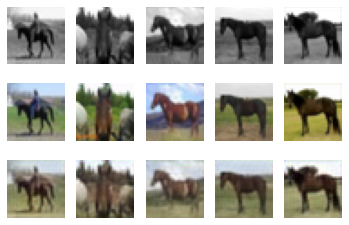

13 Train Losses: 0.0041198924548662965
13 Validation Losses: 0.004326059897721279
Train Images Results


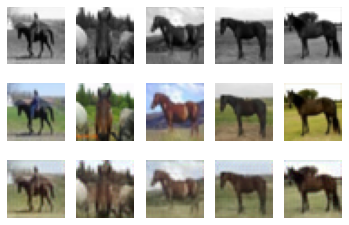

14 Train Losses: 0.004031891179727806
14 Validation Losses: 0.004260971814801451
Train Images Results


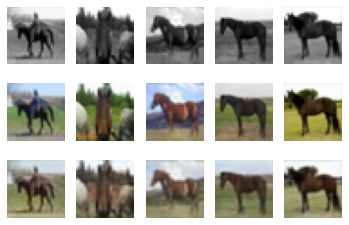

15 Train Losses: 0.003950970953294806
15 Validation Losses: 0.004210822989989538
Train Images Results


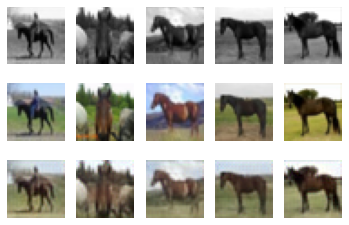

16 Train Losses: 0.0038764175371664347
16 Validation Losses: 0.004184959914709907
Train Images Results


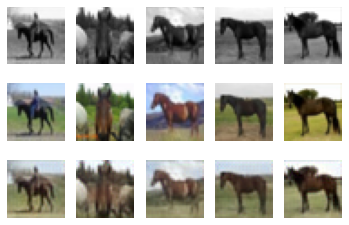

17 Train Losses: 0.003806698816727586
17 Validation Losses: 0.004164563928497955
Train Images Results


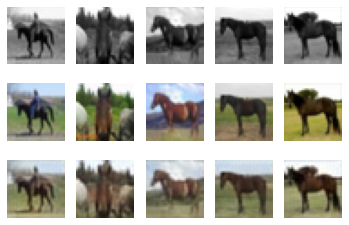

18 Train Losses: 0.003741642519546922
18 Validation Losses: 0.004151494234974962
Train Images Results


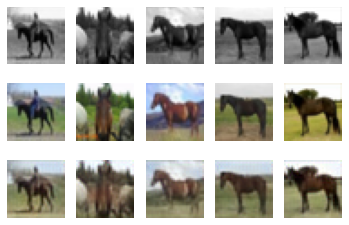

19 Train Losses: 0.003680936286261507
19 Validation Losses: 0.004102209000848234
Train Images Results


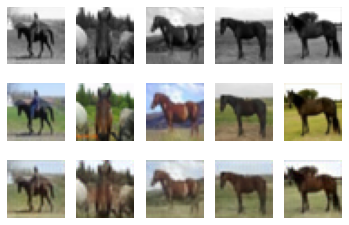

20 Train Losses: 0.0036231626750557284
20 Validation Losses: 0.004104552783246618
Train Images Results


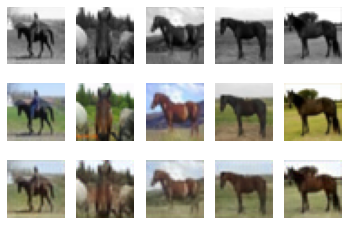

21 Train Losses: 0.0035675371341573393
21 Validation Losses: 0.004085348249645904
Train Images Results


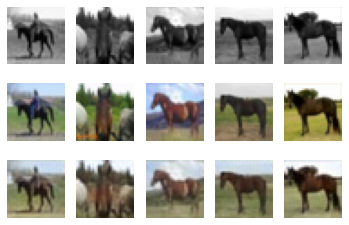

22 Train Losses: 0.003513912906110951
22 Validation Losses: 0.0041127350414171815
Train Images Results


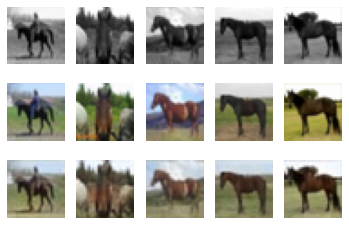

23 Train Losses: 0.003461537405160392
23 Validation Losses: 0.0040908139271778055
Train Images Results


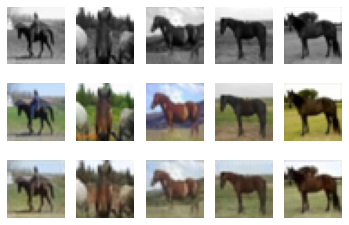

24 Train Losses: 0.003408839338856518
24 Validation Losses: 0.004104311097762547
Train Images Results


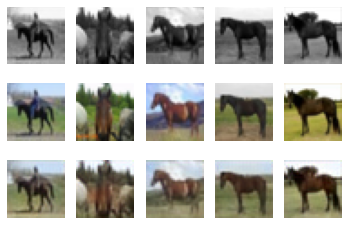

Final Validation Images Results


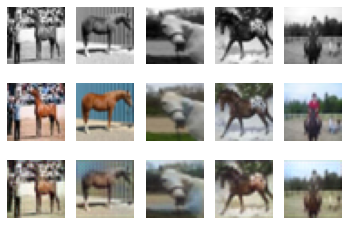

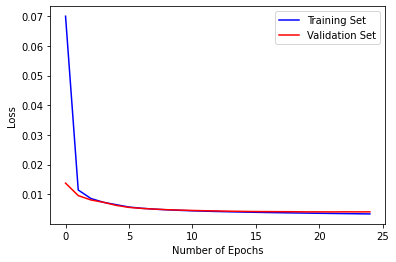

In [120]:
# Main training loop for UNet
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "UNet",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001, 
    "batch_size": 32,
    "epochs": 25,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}
args.update(args_dict)
cnn = train(args)
filename = 'final_model.sav'
pickle.dump(model, open(filename, 'wb'))

If we increase batch size too much then it affects the models performance, as we can see for 256 batch size. Now we can see that 32 batch size is working properly and converging quickly. So we can say that larger batch sizes takes more time to optimize our model.

# PART B - Conditional GAN [30 pt]

In this second half of the assignment we will construct a conditional generative adversarial network for our image colourization task.

## Part 1. Conditional GAN [15 pt]

To start we will be modifying the previous sample code to construct and train a conditional GAN. We will exploring the different architectures to identify and select our best image colourization model.

Note: This second half of the assignment should be started after the lecture on generative adversarial networks (GANs). 


### Part (a) [3 pt]
Modify the provided training code to implement a generator. Then test to verify it works on the desired input (Hint: you can reuse some of your earlier autoencoder models here to act as a generator)

In [121]:
class Generator(nn.Module):
    def __init__(self, kernel, num_filters, num_colours=3, num_in_channels=1):
        super().__init__()

        # Useful parameters
        stride = 2
        padding = kernel // 2
        output_padding = 1
        filter_no = num_filters
        ############### YOUR CODE GOES HERE ############### 
        ###################################################
        self.upconv_input = nn.Sequential(
            nn.Conv2d(1, filter_no*2, kernel_size=kernel,stride = 2, padding= padding),
            nn.BatchNorm2d(filter_no*2),
            nn.LeakyReLU(0.2, inplace=True),)
        
        self.upconv_label = nn.Sequential(
            nn.Conv2d(1, filter_no*2, kernel_size=kernel,stride = 2, padding= padding),
            nn.BatchNorm2d(filter_no*2),
            nn.LeakyReLU(0.2, inplace=True),)
        
        self.upconv_input1 = nn.Sequential(
            nn.Conv2d(filter_no*2, filter_no*4, kernel_size=kernel,stride = 2, padding= padding),
            nn.BatchNorm2d(filter_no*4),
            nn.LeakyReLU(0.2, inplace=True),)
        
        self.upconv_label1 = nn.Sequential(
            nn.Conv2d(filter_no*2, filter_no*4, kernel_size=kernel,stride = 2, padding= padding),
            nn.BatchNorm2d(filter_no*4),
            nn.LeakyReLU(0.2, inplace=True),)

        self.upconv1 = nn.Sequential(
            nn.ConvTranspose2d(filter_no*8, filter_no*8, kernel_size=kernel,stride = 2, padding= padding, output_padding = 1),
            nn.BatchNorm2d(filter_no*8),
            nn.LeakyReLU(0.2, inplace=True),)
        
        self.upconv2 = nn.Sequential(
            nn.ConvTranspose2d(filter_no*8, filter_no*4, kernel_size=kernel,stride = 1, padding= padding),
            nn.BatchNorm2d(filter_no*4),
            nn.LeakyReLU(0.2, inplace=True),)
        
        self.upconv3 = nn.Sequential(
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose2d(filter_no*4, 3, kernel_size=kernel,stride = 1, padding= padding),
            nn.BatchNorm2d(3),
            nn.LeakyReLU(0.2, inplace=True),)
        
        self.finalconv = nn.Sequential(
            nn.Conv2d(3, 3, kernel_size=kernel,stride = 1, padding= padding),)



    def forward(self,input,labels):
        ############### YOUR CODE GOES HERE ###############
        ###################################################
        x = self.upconv_input(input)
        y = self.upconv_label(labels)
        x = self.upconv_input1(x)
        y = self.upconv_label1(y)
        out = torch.cat([x,y],1)
        out = self.upconv1(out)
        out = self.upconv2(out)
        out = self.upconv3(out)
        out = self.finalconv(out)

        return out

In [122]:
#test generator architecture

model_gen = Generator(3,32)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model_gen.to(device)

summary(model_gen,[(1,32,32),(1,32,32)])

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 16, 16]             640
       BatchNorm2d-2           [-1, 64, 16, 16]             128
         LeakyReLU-3           [-1, 64, 16, 16]               0
            Conv2d-4           [-1, 64, 16, 16]             640
       BatchNorm2d-5           [-1, 64, 16, 16]             128
         LeakyReLU-6           [-1, 64, 16, 16]               0
            Conv2d-7            [-1, 128, 8, 8]          73,856
       BatchNorm2d-8            [-1, 128, 8, 8]             256
         LeakyReLU-9            [-1, 128, 8, 8]               0
           Conv2d-10            [-1, 128, 8, 8]          73,856
      BatchNorm2d-11            [-1, 128, 8, 8]             256
        LeakyReLU-12            [-1, 128, 8, 8]               0
  ConvTranspose2d-13          [-1, 256, 16, 16]         590,080
      BatchNorm2d-14          [-1, 256,

### Part (b) [3 pt]
Modify the provided training code to implement a discriminator. Then test to verify it works on the desired input.

In [123]:
noise = torch.rand(1,1,32,32)

In [124]:
noise

tensor([[[[0.2012, 0.5486, 0.1910,  ..., 0.6437, 0.1796, 0.5586],
          [0.4417, 0.8588, 0.3486,  ..., 0.0718, 0.6261, 0.0455],
          [0.4782, 0.4195, 0.7181,  ..., 0.1129, 0.4961, 0.0996],
          ...,
          [0.9218, 0.4569, 0.2806,  ..., 0.8799, 0.5181, 0.0171],
          [0.7614, 0.6451, 0.5174,  ..., 0.9358, 0.7014, 0.1546],
          [0.5226, 0.8791, 0.5024,  ..., 0.6421, 0.9581, 0.6785]]]])

In [125]:
# discriminator code

class Discriminator(nn.Module):
    def __init__(self, kernel, num_filters, num_colours=3, num_in_channels=1):
        super().__init__()
        
        # Useful parameters
        stride = 2
        padding = kernel // 2
        output_padding = 1
        filter_no = num_filters
        ############### YOUR CODE GOES HERE ############### 
        ##################################################
        self.upconv_input = nn.Sequential(
            nn.Conv2d(3, filter_no*2, kernel_size=kernel,stride = 2, padding= padding),
            nn.BatchNorm2d(filter_no*2),
            nn.LeakyReLU(0.2, inplace=True),)
        
        self.upconv_label = nn.Sequential(
            nn.Conv2d(1, filter_no*2, kernel_size=kernel,stride = 2, padding= padding),
            nn.BatchNorm2d(filter_no*2),
            nn.LeakyReLU(0.2, inplace=True),)

        self.downconv1 = nn.Sequential(
            nn.Conv2d(filter_no*4, filter_no*2, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(filter_no*2),
            nn.LeakyReLU(0.2, inplace=True),)

        self.downconv2 = nn.Sequential(
            nn.ConvTranspose2d(filter_no*2, filter_no, kernel_size=kernel,stride = 1, padding= padding),
            nn.BatchNorm2d(filter_no),
            nn.LeakyReLU(0.2, inplace=True),)
        
        self.downconv3 = nn.Sequential(
            nn.ConvTranspose2d(filter_no, 1, kernel_size=kernel,stride = 2, padding= padding, output_padding = 1),
            nn.BatchNorm2d(1),
            nn.LeakyReLU(0.2, inplace=True),)

        
        self.linear = nn.Sequential(
            nn.Linear(32 * 32 * 1, 256),
            nn.Dropout(0.5),    
            nn.Linear(256, 64),
            nn.Dropout(0.5),
            nn.Linear(64,1),
            )
    
    def forward(self, x, img_greyscale):
        
        ############### YOUR CODE GOES HERE ###############
        ###################################################
        #noise = torch.rand(2,1,32,32)
        #fake_images = model_gen(noise,img_greyscale)

        x = self.upconv_input(x)
        y = self.upconv_label(img_greyscale)
        out = torch.cat([x,y],1)
        out = self.downconv1(out)
        out = self.downconv2(out)
        out = self.downconv3(out)
        out = out.view(-1, 1 * 32 * 32)
        out = self.linear(out)
        out = torch.sigmoid(out)
        return out

In [126]:
# test discriminator architecture

model_dis = Discriminator(3,32)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model_dis.to(device)

summary(model_dis,[(3,32,32),(1,32,32)])

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 16, 16]           1,792
       BatchNorm2d-2           [-1, 64, 16, 16]             128
         LeakyReLU-3           [-1, 64, 16, 16]               0
            Conv2d-4           [-1, 64, 16, 16]             640
       BatchNorm2d-5           [-1, 64, 16, 16]             128
         LeakyReLU-6           [-1, 64, 16, 16]               0
            Conv2d-7           [-1, 64, 16, 16]          73,792
       BatchNorm2d-8           [-1, 64, 16, 16]             128
         LeakyReLU-9           [-1, 64, 16, 16]               0
  ConvTranspose2d-10           [-1, 32, 16, 16]          18,464
      BatchNorm2d-11           [-1, 32, 16, 16]              64
        LeakyReLU-12           [-1, 32, 16, 16]               0
  ConvTranspose2d-13            [-1, 1, 32, 32]             289
      BatchNorm2d-14            [-1, 1,

### Part (c) [3 pt]
Modify the provided training code to implement a conditional GAN.

In [127]:
class AttrDict(dict):
    def __init__(self, *args, **kwargs):
        super(AttrDict, self).__init__(*args, **kwargs)
        self.__dict__ = self

def get_torch_vars(xs, ys, gpu=False):
    """
    Helper function to convert numpy arrays to pytorch tensors.
    If GPU is used, move the tensors to GPU.

    Args:
      xs (float numpy tenosor): greyscale input
      ys (int numpy tenosor): categorical labels
      gpu (bool): whether to move pytorch tensor to GPU
    Returns:
      Variable(xs), Variable(ys)
    """
    xs = torch.from_numpy(xs).float()
    ys = torch.from_numpy(ys).float() #--> ADDED for cGAN
    if gpu:
        xs = xs.cuda()
        ys = ys.cuda()
    return Variable(xs), Variable(ys)

def train(args, cnn=None):
    # Set the maximum number of threads to prevent crash in Teaching Labs
    # TODO: necessary?
    torch.set_num_threads(5)
    # Numpy random seed
    npr.seed(args.seed)

    # Save directory
    save_dir = "outputs/" + args.experiment_name

    # LOAD THE COLOURS CATEGORIES

    # INPUT CHANNEL
    num_in_channels = 1 if not args.downsize_input else 3
    # LOAD THE MODEL
    if cnn is None:
        Net = globals()[args.model]
        cnn = Generator(args.kernel, args.num_filters)
        discriminator = Discriminator(args.kernel, args.num_filters)


    # LOSS FUNCTION

    criterion =  nn.BCELoss()                                                  
    g_optimizer = torch.optim.Adam(cnn.parameters(), args.learn_rate)
    d_optimizer = torch.optim.Adam(discriminator.parameters(), args.learn_rate)

    # DATA
    print("Loading data...")
    (x_train, y_train), (x_test, y_test) = load_cifar10()

    print("Transforming data...")
    train_rgb, train_grey = process(x_train, y_train, downsize_input=args.downsize_input)
    test_rgb, test_grey = process(x_test, y_test, downsize_input=args.downsize_input)

    # Create the outputs folder if not created already
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)

    print("Beginning training ...")
    if args.gpu:
        cnn.cuda()
        discriminator.cuda()
    start = time.time()

    g_train_losses = np.zeros(args.epochs)
    g_valid_losses = np.zeros(args.epochs)
    d_train_losses = np.zeros(args.epochs)
    d_valid_losses = np.zeros(args.epochs)
    valid_accs = []
    valid_accs = []
    for epoch in range(args.epochs):
        # Train the Model
        cnn.train()
        discriminator.train()
        g_total_train_loss = 0
        d_total_train_loss = 0
        g_total_val_loss = 0
        d_total_val_loss = 0
 
        for i, (xs, ys) in enumerate(get_batch(train_grey, train_rgb, args.batch_size)):
            images_train, labels_train = get_torch_vars(xs, ys, args.gpu)

            #--->ADDED 5
            img_grey = images_train
            img_real = labels_train
            batch_size = args.batch_size
            
            #discriminator training
            d_optimizer.zero_grad()

            # discriminator losses on real images 
            D_real = discriminator(img_real,img_grey)
            labels = torch.zeros(batch_size).cuda()
            d_real_loss = criterion(D_real.squeeze(), labels)
            
            # discriminator losses on fake images
            noise = Variable(torch.randn(batch_size,1,32,32)).cuda()
            fake_images_train = cnn(noise,img_grey)######################

            D_fake = discriminator(fake_images_train,img_grey)
            labels = torch.ones(batch_size).cuda() # fake labels = 1
            d_fake_loss = criterion(D_fake.squeeze(), labels)
            
            # add up losses and update parameters
            d_loss = d_real_loss + d_fake_loss 
            d_total_train_loss += d_loss.data.item()  
            d_loss.backward()
            d_optimizer.step()

            # generator training
            g_optimizer.zero_grad()
            
            # generator losses on fake images
            noise = Variable(torch.randn(batch_size,1,32,32)).cuda()
            fake_images = cnn(noise,img_grey)#######################
          
            D_fake = discriminator(fake_images,img_grey)
            labels = Variable(torch.zeros(batch_size)).cuda() #flipped labels###############

            # compute loss and update parameters
            g_loss = criterion(D_fake.squeeze(), labels)
            g_total_train_loss += g_loss.data.item()
            g_loss.backward()
            g_optimizer.step()
        g_train_losses[epoch] = float(g_total_train_loss) / (i+1)
        d_train_losses[epoch] = float(d_total_train_loss) / (i+1)
        print(epoch,"Generator Train Losses:", g_train_losses[epoch])
        print(epoch,"Discriminator Train Losses:", d_train_losses[epoch])

        cnn.eval()
        for i, (xs, ys) in enumerate(get_batch(test_grey, test_rgb, args.batch_size)):
            images_val, labels_val = get_torch_vars(xs, ys, args.gpu)

            #--->ADDED 5
            img_grey = images_val
            img_real = labels_val
            batch_size = args.batch_size

            # discriminator losses on real images 
            D_real = discriminator(img_real,img_grey)
            labels = torch.zeros(batch_size).cuda()
            d_real_loss = criterion(D_real.squeeze(), labels)
            
            # discriminator losses on fake images
            noise = Variable(torch.randn(batch_size,1,32,32)).cuda()
            fake_images_val = cnn(noise,img_grey)######################

            D_fake = discriminator(fake_images_val,img_grey)
            labels = torch.ones(batch_size).cuda() # fake labels = 1
            d_fake_loss = criterion(D_fake.squeeze(), labels)
            
            # add up losses and update parameters
            d_loss = d_real_loss + d_fake_loss  
            d_total_val_loss += d_loss.data.item()  
            
            # generator losses on fake images
            noise = Variable(torch.randn(batch_size,1,32,32)).cuda()
            fake_images = cnn(noise,img_grey)#######################
          
            D_fake = discriminator(fake_images,img_grey)
            labels = Variable(torch.zeros(batch_size)).cuda() #flipped labels###############

            # compute loss and update parameters
            g_loss = criterion(D_fake.squeeze(), labels)
            g_total_val_loss += g_loss.data.item()
        g_valid_losses[epoch] = float(g_total_val_loss) / (i+1)
        d_valid_losses[epoch] = float(d_total_val_loss) / (i+1)
        print(epoch,"Generator Validation Losses:", g_valid_losses[epoch])
        print(epoch,"Discriminator Validation Losses:", d_valid_losses[epoch])
        print("Train Images Results")
        if args.plot:
          visual(images_train, labels_train, fake_images_train, args.gpu, 1)

    print("Final Validation Images Results")
 
    if args.plot:
          visual(images_val, labels_val, fake_images_val, args.gpu, 1)
    #Generator Plots
    plt.subplots(figsize=(6, 4))
    plt.plot(range(epoch+1), g_train_losses, color="blue", label="Training Set")
    plt.plot(range(epoch+1), g_valid_losses, color="red", label="Validation Set")
    plt.legend()
    plt.title("Generator Plots")
    plt.xlabel("Number of Epochs")
    plt.ylabel("Loss")
    plt.show()

    #Discriminator Plots
    plt.subplots(figsize=(6, 4))
    plt.plot(range(epoch+1), d_train_losses, color="blue", label="Training Set")
    plt.plot(range(epoch+1), d_valid_losses, color="red", label="Validation Set")
    plt.legend()
    plt.title("Discriminator Plots")
    plt.xlabel("Number of Epochs")
    plt.ylabel("Loss")
    plt.show()


    return cnn

### Part (d) [3 pt]
Train a conditional GAN for image colourization.

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...
0 Generator Train Losses: 3.1027004927396775
0 Discriminator Train Losses: 0.4493803923856467


0 Generator Validation Losses: 6.575980687141419
0 Discriminator Validation Losses: 0.009448829316534102
Train Images Results


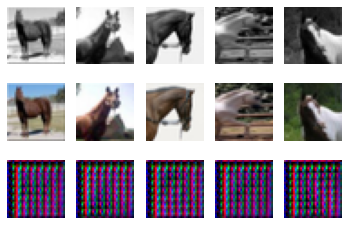

1 Generator Train Losses: 7.0429497337341305
1 Discriminator Train Losses: 0.006595552391372621


1 Generator Validation Losses: 5.978529620170593
1 Discriminator Validation Losses: 0.009401006251573562
Train Images Results


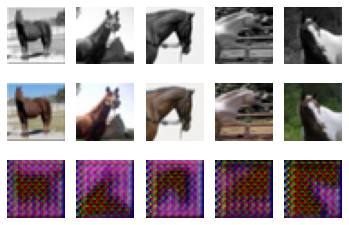

2 Generator Train Losses: 7.475059704780579
2 Discriminator Train Losses: 0.044472521147690715


2 Generator Validation Losses: 7.733343029022217
2 Discriminator Validation Losses: 0.020804137759841978
Train Images Results


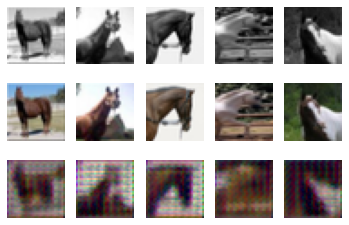

3 Generator Train Losses: 6.664789443016052
3 Discriminator Train Losses: 0.11609883555211127


3 Generator Validation Losses: 9.278875160217286
3 Discriminator Validation Losses: 0.0712456988170743
Train Images Results


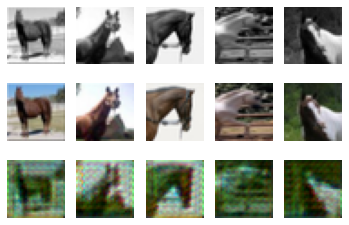

4 Generator Train Losses: 7.667899141311645
4 Discriminator Train Losses: 0.06147678151726723
4 Generator Validation Losses: 6.813793873786926
4 Discriminator Validation Losses: 0.015226956154219807
Train Images Results


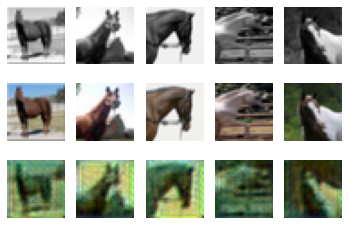

5 Generator Train Losses: 8.21127378463745
5 Discriminator Train Losses: 0.25038414969923906


5 Generator Validation Losses: 3.468975245952606
5 Discriminator Validation Losses: 0.1318569228053093
Train Images Results


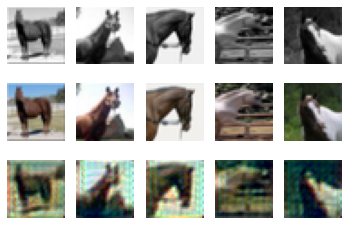

6 Generator Train Losses: 6.840438613891601
6 Discriminator Train Losses: 0.05618514669593424


6 Generator Validation Losses: 6.236810946464539
6 Discriminator Validation Losses: 0.019516785629093647
Train Images Results


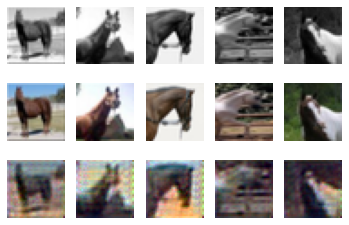

7 Generator Train Losses: 10.603417549133301
7 Discriminator Train Losses: 0.1145040558744222


7 Generator Validation Losses: 3.2660077929496767
7 Discriminator Validation Losses: 0.1756004925817251
Train Images Results


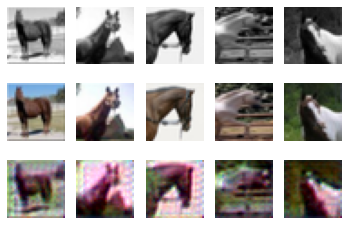

8 Generator Train Losses: 8.282324775457383
8 Discriminator Train Losses: 0.1122046181303449


8 Generator Validation Losses: 6.5552854299545285
8 Discriminator Validation Losses: 0.04225154547020793
Train Images Results


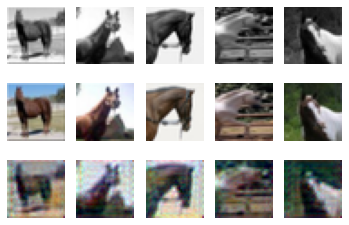

9 Generator Train Losses: 7.456036686897278
9 Discriminator Train Losses: 0.0258129001269117


9 Generator Validation Losses: 13.976814222335815
9 Discriminator Validation Losses: 0.15324863484129309
Train Images Results


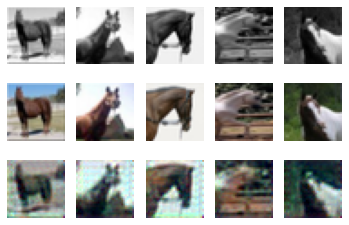

10 Generator Train Losses: 9.853633518218993
10 Discriminator Train Losses: 0.02487744835438207


10 Generator Validation Losses: 9.033667802810669
10 Discriminator Validation Losses: 0.035956646944396195
Train Images Results


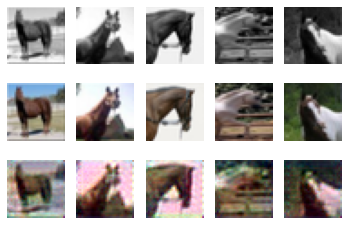

11 Generator Train Losses: 9.045794370174407
11 Discriminator Train Losses: 0.37672487859148535


11 Generator Validation Losses: 6.618884921073914
11 Discriminator Validation Losses: 0.2252993106842041
Train Images Results


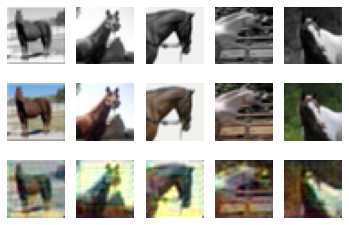

12 Generator Train Losses: 5.897910313606262
12 Discriminator Train Losses: 0.04821003098040819


12 Generator Validation Losses: 6.666557860374451
12 Discriminator Validation Losses: 0.061516883037984374
Train Images Results


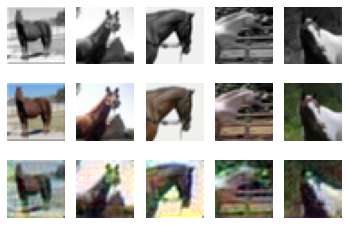

13 Generator Train Losses: 7.298962821960449
13 Discriminator Train Losses: 0.03615988612407819


13 Generator Validation Losses: 8.258881092071533
13 Discriminator Validation Losses: 0.05557195891160518
Train Images Results


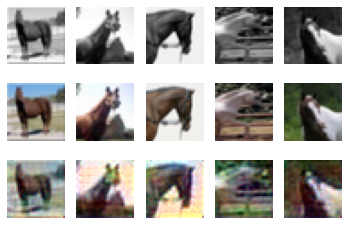

14 Generator Train Losses: 10.814232567548752
14 Discriminator Train Losses: 0.34720347286202013


14 Generator Validation Losses: 1.3910102486610412
14 Discriminator Validation Losses: 1.0434777677059173
Train Images Results


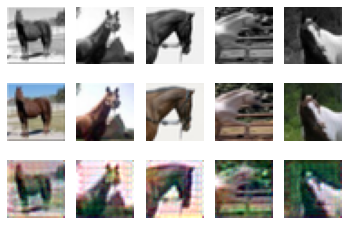

15 Generator Train Losses: 5.826775350570679
15 Discriminator Train Losses: 0.20938330285251142


15 Generator Validation Losses: 7.545656394958496
15 Discriminator Validation Losses: 0.04910455145873129
Train Images Results


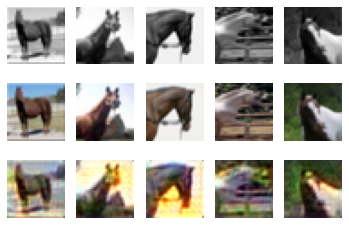

16 Generator Train Losses: 8.643758442401886
16 Discriminator Train Losses: 0.04582177558913827


16 Generator Validation Losses: 7.655555605888367
16 Discriminator Validation Losses: 0.03452965209726244
Train Images Results


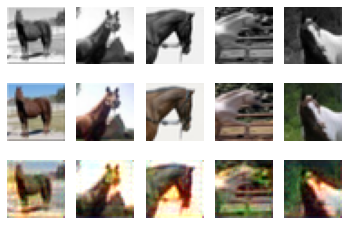

17 Generator Train Losses: 9.6111354637146
17 Discriminator Train Losses: 0.030208083165925926


17 Generator Validation Losses: 36.00356969833374
17 Discriminator Validation Losses: 0.15792409144341946
Train Images Results


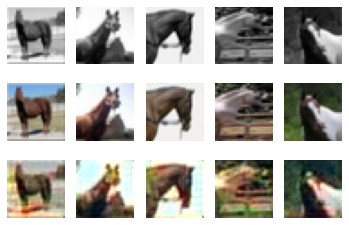

18 Generator Train Losses: 5.727811033427716
18 Discriminator Train Losses: 0.6822286207973957


18 Generator Validation Losses: 5.119951820373535
18 Discriminator Validation Losses: 0.17336020339280367
Train Images Results


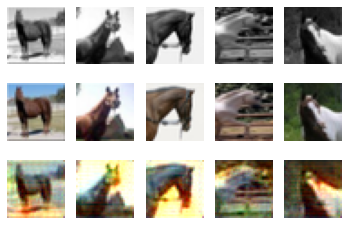

19 Generator Train Losses: 5.274766483306885
19 Discriminator Train Losses: 0.09721362015232443


19 Generator Validation Losses: 9.223690152168274
19 Discriminator Validation Losses: 0.4113159529864788
Train Images Results


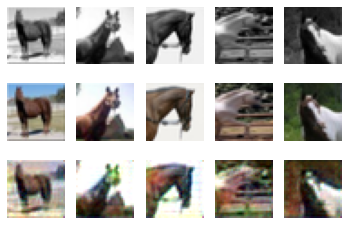

20 Generator Train Losses: 10.300981035232544
20 Discriminator Train Losses: 0.30548213676083835


20 Generator Validation Losses: 7.4091373682022095
20 Discriminator Validation Losses: 0.05576248187571764
Train Images Results


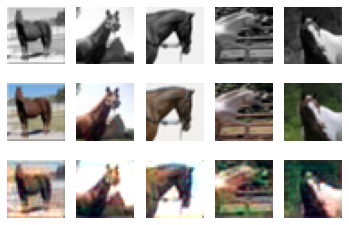

21 Generator Train Losses: 7.430806555747986
21 Discriminator Train Losses: 0.04167401559185237


21 Generator Validation Losses: 9.45158052444458
21 Discriminator Validation Losses: 0.026172599825076758
Train Images Results


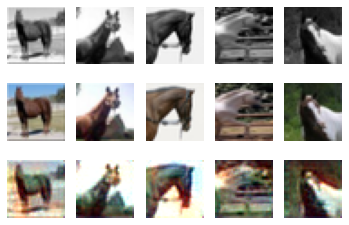

22 Generator Train Losses: 7.900984659194946
22 Discriminator Train Losses: 0.015556341297924518


22 Generator Validation Losses: 9.720064949989318
22 Discriminator Validation Losses: 0.021007979474961757
Train Images Results


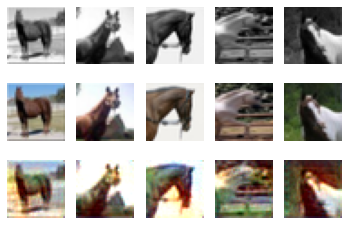

23 Generator Train Losses: 10.00557511806488
23 Discriminator Train Losses: 0.017698810853762553


23 Generator Validation Losses: 26.664800071716307
23 Discriminator Validation Losses: 0.023262515604437796
Train Images Results


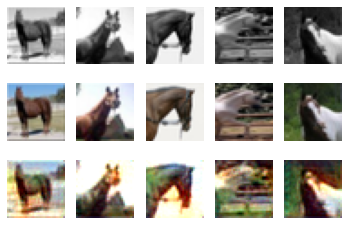

24 Generator Train Losses: 12.679870376586914
24 Discriminator Train Losses: 0.015469064756471198


24 Generator Validation Losses: 6.990454697608948
24 Discriminator Validation Losses: 0.028987804823555053
Train Images Results


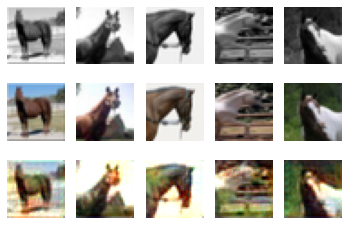

Final Validation Images Results


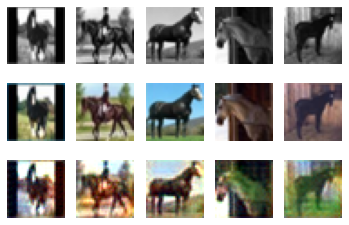

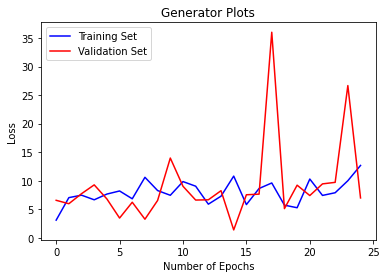

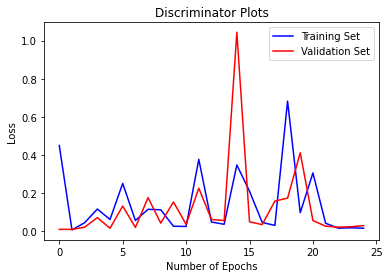

In [128]:
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "Generator",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.0001, 
    "batch_size": 50,
    "epochs": 25,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}
args.update(args_dict)
cnn = train(args)

#batch size of 50 with 100 epochs seamed to work

### Part (e) [1 pt]
How does the performance of the cGAN compare with the autoencoder models that you tested in the first half of this assignment?

Answer: Autoencoder was easy to train and tune, while in case of cGAN it is tough to train the model and the results we are achieving in case of cGAN are little bit poor as compared to autoencoder, since we are generating images from random noise. But if we involve enough complexity in our model then we can achieve better results.

### Part (f) [2 pt]

A colour space is a choice of mapping of colours into three-dimensional coordinates. Some colours could be close together in one colour space, but further apart in others. The RGB colour space is probably the most familiar to you, the model used in in our regression colourization example computes squared error in RGB colour space. But, most state of the art colourization models
do not use RGB colour space. How could using the RGB colour space be problematic? Your answer should relate how human perception of colour is different than the squared distance. You may use the Wikipedia article on colour space to help you answer the question.

Answer:


RGB is a device-dependent color model and can only really be used successfully on screens and, in some cases, conventional photography.

This refers to the colors you are able to see on the screen right now, it does not translate the same way through printing.

In most printing processes, RGB color space is usually converted to CMYK before creating the artwork.

Essentially, any colors produced with RGB on the digital space will not create the same output on the physical print.

This is based on the color gamut, which in other words means that translating RGB to CMYK usually allows the color to convert only as close to the original appearance of the display screen.

Therefore, working in a CMYK color space allows the artwork to look exactly or as close as possible to the real-life design you will get when it becomes printed on paper or packaging.

ref:https://pakfactory.com/blog/rgb-color-model-printing-packaging/



## Part 2. Exploration [10 pt]

At this point we have trained a few different generative models for our image colourization task with varying results. What makes this work exciting is that there many other approaches we could take. In this part of the assignment you will be exploring at least one of several approaches towards improving our performance on the image colourization task. Some well known approaches you can consider include:

- lab colour space representation instead of RBG which simplifies the problem and requires you to predict two output channels instead of three
- k-means to represent RBG colourspace by 'k' distinct colours, this effectively changes the problem from regression to classification.

Other interesting approaches include:
- combining L1 loss along with the discriminator-based loss
- starting with a pretrained generator (i.e. Resnet)
- patch discriminator trained on local regions

A great example of some of these different approaches can be found in a <a href="https://towardsdatascience.com/colorizing-black-white-images-with-u-net-and-conditional-gan-a-tutorial-81b2df111cd8">blog post by Moein Shariatnia</a>.

Note you are only required to pick one of the suggested modifications.

**We will implement L1 loss along with discriminator based loss**

In [129]:
# provide your code here
def train_modified(args, cnn=None):
    # Set the maximum number of threads to prevent crash in Teaching Labs
    # TODO: necessary?
    torch.set_num_threads(5)
    # Numpy random seed
    npr.seed(args.seed)

    # Save directory
    save_dir = "outputs/" + args.experiment_name

    # LOAD THE COLOURS CATEGORIES

    # INPUT CHANNEL
    num_in_channels = 1 if not args.downsize_input else 3
    # LOAD THE MODEL
    if cnn is None:
        Net = globals()[args.model]
        cnn = Generator(args.kernel, args.num_filters)
        discriminator = Discriminator(args.kernel, args.num_filters)


    # LOSS FUNCTION

    GANcriterion =  nn.BCELoss() 
    L1criterian = nn.L1Loss()

    g_optimizer = torch.optim.Adam(cnn.parameters(), args.learn_rate)
    d_optimizer = torch.optim.Adam(discriminator.parameters(), args.learn_rate)

    # DATA
    print("Loading data...")
    (x_train, y_train), (x_test, y_test) = load_cifar10()

    print("Transforming data...")
    train_rgb, train_grey = process(x_train, y_train, downsize_input=args.downsize_input)
    test_rgb, test_grey = process(x_test, y_test, downsize_input=args.downsize_input)

    # Create the outputs folder if not created already
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)

    print("Beginning training ...")
    if args.gpu:
        cnn.cuda()
        discriminator.cuda()
    start = time.time()

    g_train_losses = np.zeros(args.epochs)
    g_valid_losses = np.zeros(args.epochs)
    d_train_losses = np.zeros(args.epochs)
    d_valid_losses = np.zeros(args.epochs)
    valid_accs = []
    valid_accs = []
    for epoch in range(args.epochs):
        # Train the Model
        cnn.train()
        discriminator.train()
        g_total_train_loss = 0
        d_total_train_loss = 0
        g_total_val_loss = 0
        d_total_val_loss = 0
 
        for i, (xs, ys) in enumerate(get_batch(train_grey, train_rgb, args.batch_size)):
            images_train, labels_train = get_torch_vars(xs, ys, args.gpu)

            #--->ADDED 5
            img_grey = images_train
            img_real = labels_train
            batch_size = args.batch_size
            
            #discriminator training
            d_optimizer.zero_grad()

            # discriminator losses on real images 
            D_real = discriminator(img_real,img_grey)
            labels = torch.zeros(batch_size).cuda()
            d_real_loss = GANcriterion(D_real.squeeze(), labels)
            
            # discriminator losses on fake images
            noise = Variable(torch.randn(batch_size,1,32,32)).cuda()
            fake_images_train = cnn(noise,img_grey)######################

            D_fake = discriminator(fake_images_train,img_grey)
            labels = torch.ones(batch_size).cuda() # fake labels = 1
            d_fake_loss = GANcriterion(D_fake.squeeze(), labels)
            
            # add up losses and update parameters
            d_loss = d_real_loss + d_fake_loss 
            d_total_train_loss += d_loss.data.item()  
            d_loss.backward()
            d_optimizer.step()

            # generator training
            g_optimizer.zero_grad()
            
            # generator losses on fake images
            noise = Variable(torch.randn(batch_size,1,32,32)).cuda()
            fake_images = cnn(noise,img_grey)#######################
          
            D_fake = discriminator(fake_images,img_grey)
            labels = Variable(torch.zeros(batch_size)).cuda() #flipped labels###############

            # compute loss and update parameters
            g_loss_gan = GANcriterion(D_fake.squeeze(), labels)
            g_loss_l1 = L1criterian(fake_images,img_real)*args.lambda_l1
            g_loss = g_loss_gan + g_loss_l1
            g_total_train_loss += g_loss.data.item()
            g_loss.backward()
            g_optimizer.step()
        g_train_losses[epoch] = float(g_total_train_loss) / (i+1)
        d_train_losses[epoch] = float(d_total_train_loss) / (i+1)
        print(epoch,"Generator Train Losses:", g_train_losses[epoch])
        print(epoch,"Discriminator Train Losses:", d_train_losses[epoch])

        cnn.eval()
        for i, (xs, ys) in enumerate(get_batch(test_grey, test_rgb, args.batch_size)):
            images_val, labels_val = get_torch_vars(xs, ys, args.gpu)

            #--->ADDED 5
            img_grey = images_val
            img_real = labels_val
            batch_size = args.batch_size

            # discriminator losses on real images 
            D_real = discriminator(img_real,img_grey)
            labels = torch.zeros(batch_size).cuda()
            d_real_loss = GANcriterion(D_real.squeeze(), labels)
            
            # discriminator losses on fake images
            noise = Variable(torch.randn(batch_size,1,32,32)).cuda()
            fake_images_val = cnn(noise,img_grey)######################

            D_fake = discriminator(fake_images_val,img_grey)
            labels = torch.ones(batch_size).cuda() # fake labels = 1
            d_fake_loss = GANcriterion(D_fake.squeeze(), labels)
            
            # add up losses and update parameters
            d_loss = d_real_loss + d_fake_loss  
            d_total_val_loss += d_loss.data.item()  
            
            # generator losses on fake images
            noise = Variable(torch.randn(batch_size,1,32,32)).cuda()
            fake_images = cnn(noise,img_grey)#######################
          
            D_fake = discriminator(fake_images,img_grey)
            labels = Variable(torch.zeros(batch_size)).cuda() #flipped labels###############

            # compute loss and update parameters
            g_loss_gan = GANcriterion(D_fake.squeeze(), labels)
            g_loss_l1 = L1criterian(fake_images,img_real)*args.lambda_l1
            g_loss = g_loss_gan + g_loss_l1
            g_total_val_loss += g_loss.data.item()
        g_valid_losses[epoch] = float(g_total_val_loss) / (i+1)
        d_valid_losses[epoch] = float(d_total_val_loss) / (i+1)
        print(epoch,"Generator Validation Losses:", g_valid_losses[epoch])
        print(epoch,"Discriminator Validation Losses:", d_valid_losses[epoch])
        print("Train Images Results")
        if args.plot:
          visual(images_train, labels_train, fake_images_train, args.gpu, 1)

    print("Final Validation Images Results")
 
    if args.plot:
          visual(images_val, labels_val, fake_images_val, args.gpu, 1)
    #Generator Plots
    plt.subplots(figsize=(6, 4))
    plt.plot(range(epoch+1), g_train_losses, color="blue", label="Training Set")
    plt.plot(range(epoch+1), g_valid_losses, color="red", label="Validation Set")
    plt.legend()
    plt.title("Generator Plots")
    plt.xlabel("Number of Epochs")
    plt.ylabel("Loss")
    plt.show()

    #Discriminator Plots
    plt.subplots(figsize=(6, 4))
    plt.plot(range(epoch+1), d_train_losses, color="blue", label="Training Set")
    plt.plot(range(epoch+1), d_valid_losses, color="red", label="Validation Set")
    plt.legend()
    plt.title("Discriminator Plots")
    plt.xlabel("Number of Epochs")
    plt.ylabel("Loss")
    plt.show()


    return cnn

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...
0 Generator Train Losses: 75.5482975769043
0 Discriminator Train Losses: 0.21075213400181383


0 Generator Validation Losses: 67.25223121643066
0 Discriminator Validation Losses: 0.02329831961542368
Train Images Results


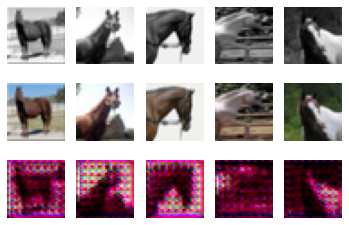

1 Generator Train Losses: 62.465463905334474
1 Discriminator Train Losses: 0.005754387871129438


1 Generator Validation Losses: 57.126480674743654
1 Discriminator Validation Losses: 0.0019626373948995026
Train Images Results


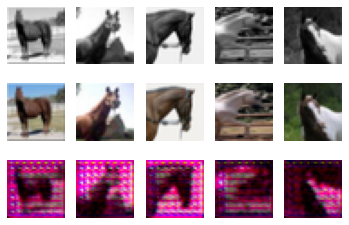

2 Generator Train Losses: 51.210586090087894
2 Discriminator Train Losses: 0.001424375070782844


2 Generator Validation Losses: 46.613797950744626
2 Discriminator Validation Losses: 0.0014432356663746759
Train Images Results


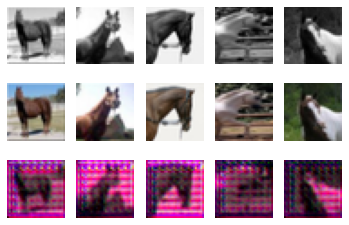

3 Generator Train Losses: 44.86684108734131
3 Discriminator Train Losses: 0.010331054768175817


3 Generator Validation Losses: 58.28819599151611
3 Discriminator Validation Losses: 0.008454878447810187
Train Images Results


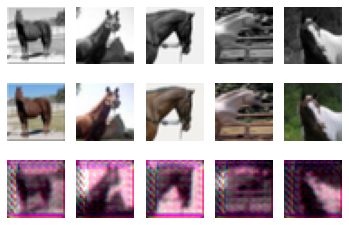

4 Generator Train Losses: 35.76727693557739
4 Discriminator Train Losses: 0.06266878907103092


4 Generator Validation Losses: 37.014464378356934
4 Discriminator Validation Losses: 0.03694953981321305
Train Images Results


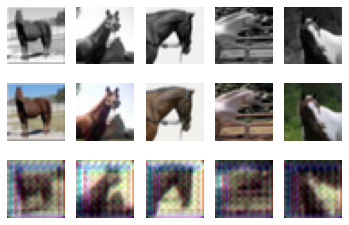

5 Generator Train Losses: 29.779881839752196
5 Discriminator Train Losses: 0.15926690778520425


5 Generator Validation Losses: 28.39598455429077
5 Discriminator Validation Losses: 0.20986991189420223
Train Images Results


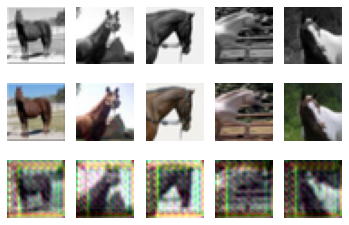

6 Generator Train Losses: 28.93894733428955
6 Discriminator Train Losses: 0.19122573990374803


6 Generator Validation Losses: 25.092269229888917
6 Discriminator Validation Losses: 0.1536565963178873
Train Images Results


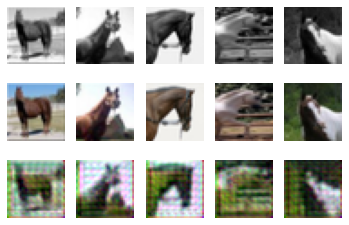

7 Generator Train Losses: 28.953381252288818
7 Discriminator Train Losses: 0.10362081138067879


7 Generator Validation Losses: 29.76580352783203
7 Discriminator Validation Losses: 0.1889854647219181
Train Images Results


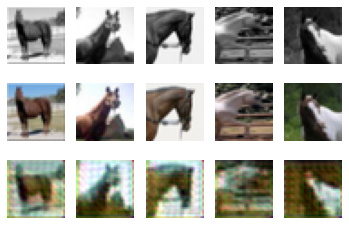

8 Generator Train Losses: 27.86341053009033
8 Discriminator Train Losses: 0.11046554493717849


8 Generator Validation Losses: 111.79352035522462
8 Discriminator Validation Losses: 0.12843385245651007
Train Images Results


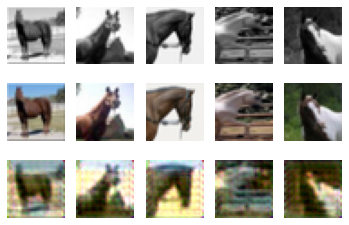

9 Generator Train Losses: 30.441399879455567
9 Discriminator Train Losses: 0.04276553292118478


9 Generator Validation Losses: 26.821832370758056
9 Discriminator Validation Losses: 0.09530589538626373
Train Images Results


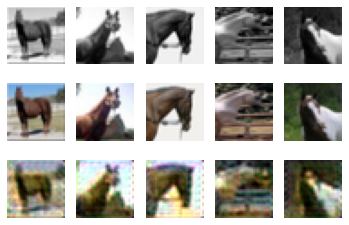

10 Generator Train Losses: 67.49585041046143
10 Discriminator Train Losses: 0.06966537601490472


10 Generator Validation Losses: 32.093854904174805
10 Discriminator Validation Losses: 0.7034637689590454
Train Images Results


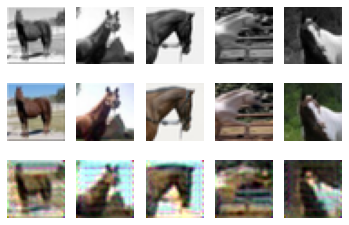

11 Generator Train Losses: 28.07643726348877
11 Discriminator Train Losses: 0.20600902161342674


11 Generator Validation Losses: 25.47378215789795
11 Discriminator Validation Losses: 0.15334065891802312
Train Images Results


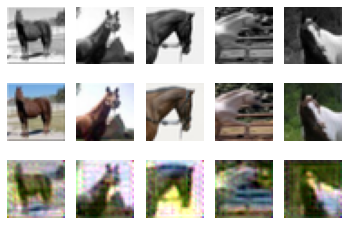

12 Generator Train Losses: 31.14771753311157
12 Discriminator Train Losses: 0.054195216157240794


12 Generator Validation Losses: 58.57584133148193
12 Discriminator Validation Losses: 0.0026982442243024705
Train Images Results


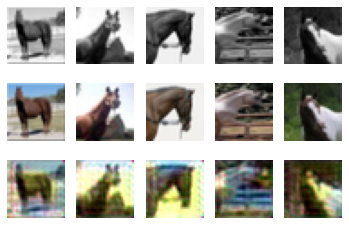

13 Generator Train Losses: 33.204355278015136
13 Discriminator Train Losses: 0.016345491006504745


13 Generator Validation Losses: 22.992215633392334
13 Discriminator Validation Losses: 0.04142865962348878
Train Images Results


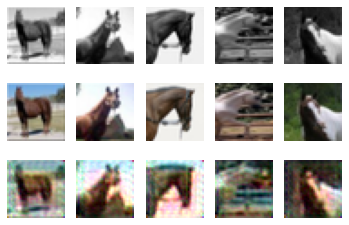

14 Generator Train Losses: 58.24629373550415
14 Discriminator Train Losses: 0.01228701272516446


14 Generator Validation Losses: 34.56603240966797
14 Discriminator Validation Losses: 0.001609945785457967
Train Images Results


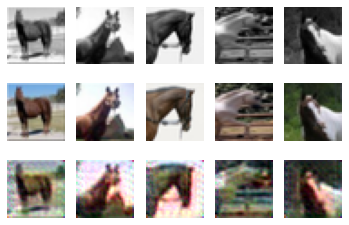

15 Generator Train Losses: 56.6638560295105
15 Discriminator Train Losses: 0.010089653818122315


15 Generator Validation Losses: 27.01065673828125
15 Discriminator Validation Losses: 0.00482216350355884
Train Images Results


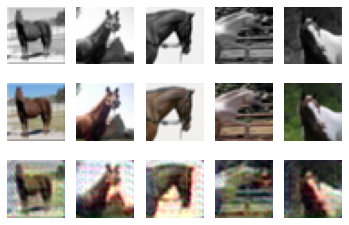

16 Generator Train Losses: 74.33764219284058
16 Discriminator Train Losses: 0.011629245711333312


16 Generator Validation Losses: 113.3929485321045
16 Discriminator Validation Losses: 0.0020914089306888427
Train Images Results


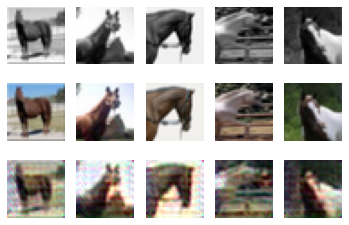

17 Generator Train Losses: 98.38003498077393
17 Discriminator Train Losses: 0.0018536357817010441


17 Generator Validation Losses: 112.2982234954834
17 Discriminator Validation Losses: 0.00570431983124422
Train Images Results


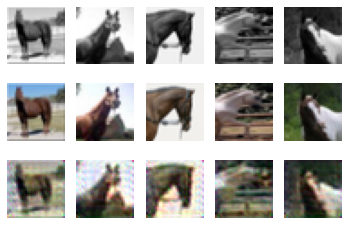

18 Generator Train Losses: 98.04680053710938
18 Discriminator Train Losses: 0.00031674342649921526


18 Generator Validation Losses: 102.33127021789551
18 Discriminator Validation Losses: 0.005822946587431943
Train Images Results


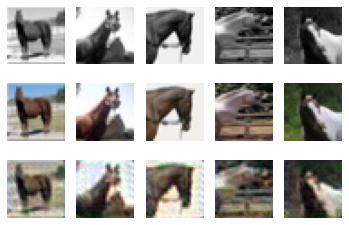

19 Generator Train Losses: 107.10862386703491
19 Discriminator Train Losses: 0.0002480063832894075


19 Generator Validation Losses: 91.78573722839356
19 Discriminator Validation Losses: 0.005781844964030824
Train Images Results


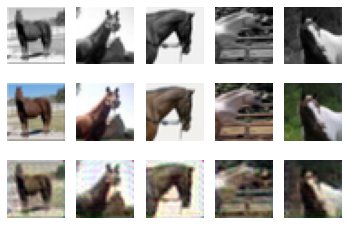

20 Generator Train Losses: 105.51687381744385
20 Discriminator Train Losses: 0.0004056802321966302


20 Generator Validation Losses: 41.10349025726318
20 Discriminator Validation Losses: 0.008149491139920428
Train Images Results


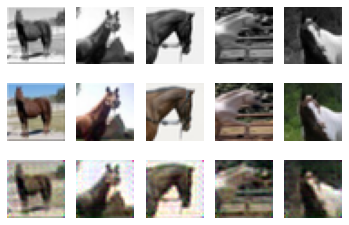

21 Generator Train Losses: 95.52705966949463
21 Discriminator Train Losses: 0.0015414032971239066


21 Generator Validation Losses: 37.07462902069092
21 Discriminator Validation Losses: 0.0661971943161916
Train Images Results


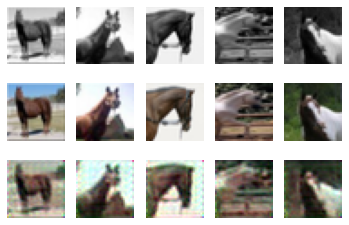

22 Generator Train Losses: 33.19196699142456
22 Discriminator Train Losses: 0.24950340171373683


22 Generator Validation Losses: 29.076908302307128
22 Discriminator Validation Losses: 0.12618503645062445
Train Images Results


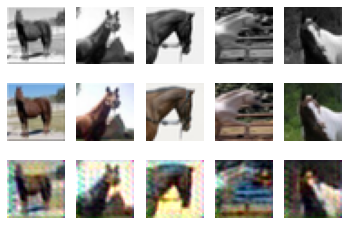

23 Generator Train Losses: 26.361033515930174
23 Discriminator Train Losses: 0.12411794606596231


23 Generator Validation Losses: 22.985367488861083
23 Discriminator Validation Losses: 0.060998633550480005
Train Images Results


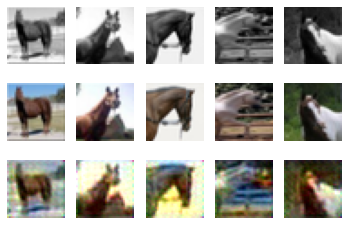

24 Generator Train Losses: 59.807311573028564
24 Discriminator Train Losses: 0.012216696133509685


24 Generator Validation Losses: 66.96738739013672
24 Discriminator Validation Losses: 0.01057145047307131
Train Images Results


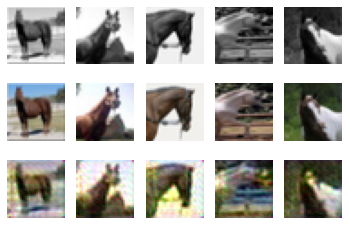

Final Validation Images Results


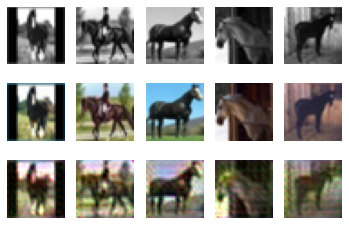

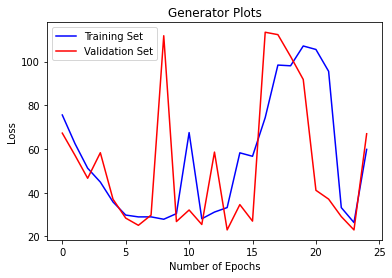

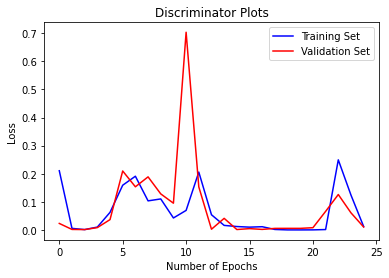

In [130]:
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "Generator",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.0001, 
    "batch_size": 50,
    "epochs": 25,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
    "lambda_l1": 200,
}
args.update(args_dict)
cnn = train_modified(args)

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...
0 Generator Train Losses: 27.929282627105714
0 Discriminator Train Losses: 0.3216731983050704


0 Generator Validation Losses: 28.49941244125366
0 Discriminator Validation Losses: 0.009264622442424297
Train Images Results


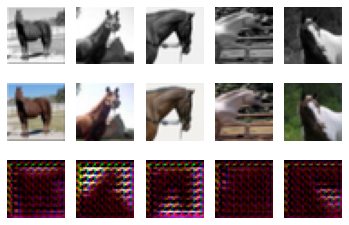

1 Generator Train Losses: 27.110543937683104
1 Discriminator Train Losses: 0.006832192162983119


1 Generator Validation Losses: 25.574502849578856
1 Discriminator Validation Losses: 0.005513300292659551
Train Images Results


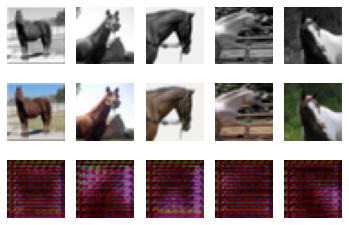

2 Generator Train Losses: 23.198024291992187
2 Discriminator Train Losses: 0.003883419705089182


2 Generator Validation Losses: 20.88603858947754
2 Discriminator Validation Losses: 0.002414758074155543
Train Images Results


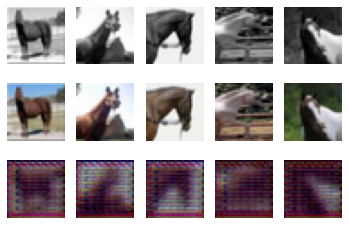

3 Generator Train Losses: 20.523287029266356
3 Discriminator Train Losses: 0.01272846598760225


3 Generator Validation Losses: 19.790856647491456
3 Discriminator Validation Losses: 0.013282845495268703
Train Images Results


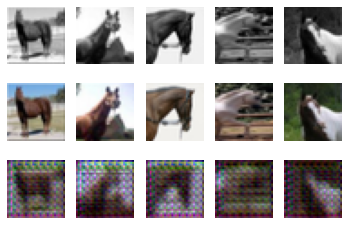

4 Generator Train Losses: 17.070418262481688
4 Discriminator Train Losses: 0.034741594167426226


4 Generator Validation Losses: 14.78656439781189
4 Discriminator Validation Losses: 0.004420953005319461
Train Images Results


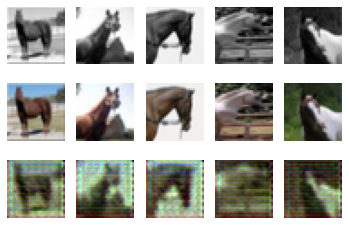

5 Generator Train Losses: 14.66583246231079
5 Discriminator Train Losses: 0.025093264716560953


5 Generator Validation Losses: 13.264635229110718
5 Discriminator Validation Losses: 0.016115342476405205
Train Images Results


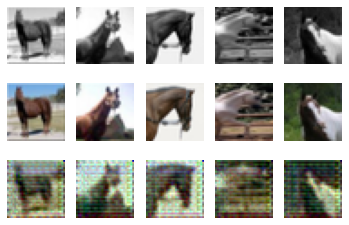

6 Generator Train Losses: 18.01006911277771
6 Discriminator Train Losses: 0.02371548586874269


6 Generator Validation Losses: 15.17925043106079
6 Discriminator Validation Losses: 0.0054385960364015775
Train Images Results


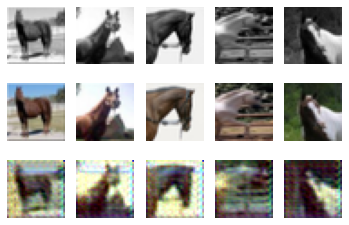

7 Generator Train Losses: 19.237077283859254
7 Discriminator Train Losses: 0.04086722432693932


7 Generator Validation Losses: 21.85159730911255
7 Discriminator Validation Losses: 0.006382768764160574
Train Images Results


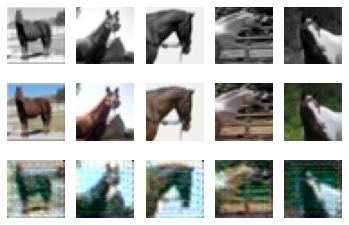

8 Generator Train Losses: 18.292422370910643
8 Discriminator Train Losses: 0.014129274111473933


8 Generator Validation Losses: 17.41631064414978
8 Discriminator Validation Losses: 0.05172815283294767
Train Images Results


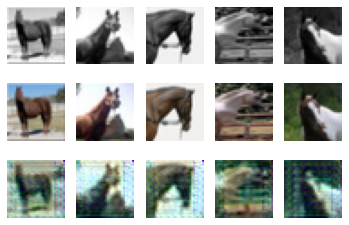

9 Generator Train Losses: 22.512574863433837
9 Discriminator Train Losses: 0.06729134555644123


9 Generator Validation Losses: 14.244612455368042
9 Discriminator Validation Losses: 0.06331568546593189
Train Images Results


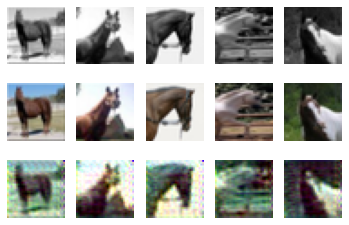

10 Generator Train Losses: 18.370468196868895
10 Discriminator Train Losses: 0.03809560769470408


10 Generator Validation Losses: 17.467566633224486
10 Discriminator Validation Losses: 0.022493799787480385
Train Images Results


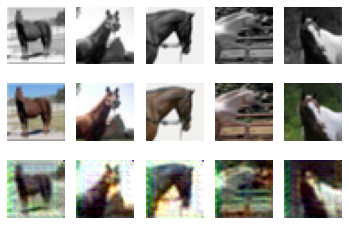

11 Generator Train Losses: 23.14369194984436
11 Discriminator Train Losses: 0.023629091764451004


11 Generator Validation Losses: 21.866941356658934
11 Discriminator Validation Losses: 0.017589510697871447
Train Images Results


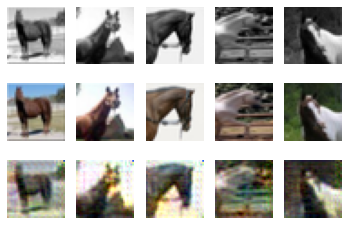

12 Generator Train Losses: 26.241810159683226
12 Discriminator Train Losses: 0.06912209582063951


12 Generator Validation Losses: 12.48258605003357
12 Discriminator Validation Losses: 0.02657024359796196
Train Images Results


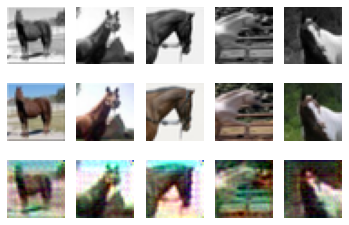

13 Generator Train Losses: 21.16612893104553
13 Discriminator Train Losses: 0.32745864719268863


13 Generator Validation Losses: 10.713224267959594
13 Discriminator Validation Losses: 0.12704476062208414
Train Images Results


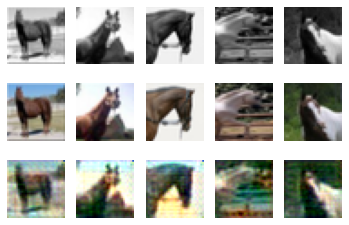

14 Generator Train Losses: 10.645399751663208
14 Discriminator Train Losses: 0.05161515648011118


14 Generator Validation Losses: 9.699495124816895
14 Discriminator Validation Losses: 0.055264542903751136
Train Images Results


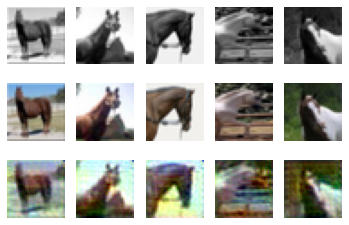

15 Generator Train Losses: 12.425015130043029
15 Discriminator Train Losses: 0.04517643106868491


15 Generator Validation Losses: 23.944489765167237
15 Discriminator Validation Losses: 0.836835003644228
Train Images Results


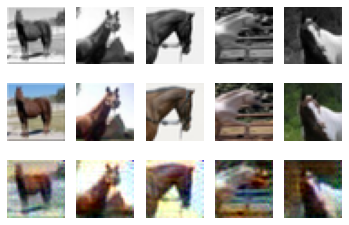

16 Generator Train Losses: 13.380467567443848
16 Discriminator Train Losses: 0.12972472858498804


16 Generator Validation Losses: 9.985002279281616
16 Discriminator Validation Losses: 0.05256834872998297
Train Images Results


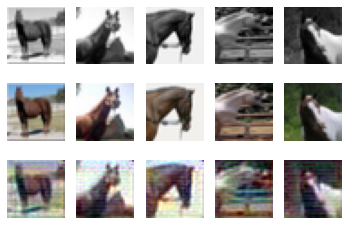

17 Generator Train Losses: 12.432999849319458
17 Discriminator Train Losses: 0.043909600968472656


17 Generator Validation Losses: 10.130918836593628
17 Discriminator Validation Losses: 0.048326086485758424
Train Images Results


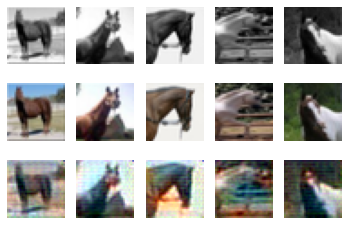

18 Generator Train Losses: 14.021576929092408
18 Discriminator Train Losses: 0.02069796384079382


18 Generator Validation Losses: 18.64756045341492
18 Discriminator Validation Losses: 0.062273033708333966
Train Images Results


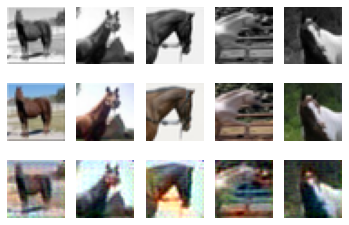

19 Generator Train Losses: 19.14755168437958
19 Discriminator Train Losses: 0.23949339337530545


19 Generator Validation Losses: 13.582682418823243
19 Discriminator Validation Losses: 0.048206450813449916
Train Images Results


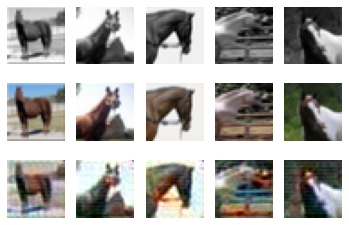

20 Generator Train Losses: 12.557267427444458
20 Discriminator Train Losses: 0.028529592012055217


20 Generator Validation Losses: 11.416135358810426
20 Discriminator Validation Losses: 0.039877056900877506
Train Images Results


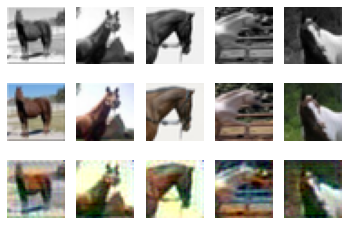

21 Generator Train Losses: 13.626992082595825
21 Discriminator Train Losses: 0.016131862349575386


21 Generator Validation Losses: 17.20261902809143
21 Discriminator Validation Losses: 0.05740461908862926
Train Images Results


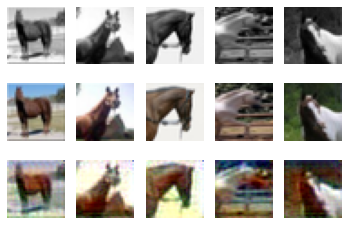

22 Generator Train Losses: 14.056493768692016
22 Discriminator Train Losses: 0.009599855139967986


22 Generator Validation Losses: 16.278551530838012
22 Discriminator Validation Losses: 0.05329287667409517
Train Images Results


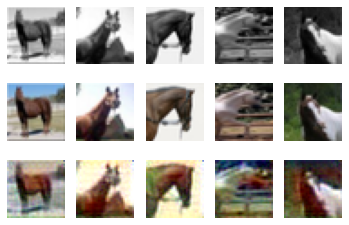

23 Generator Train Losses: 15.364765253067016
23 Discriminator Train Losses: 0.00816472046484705


23 Generator Validation Losses: 19.834658432006837
23 Discriminator Validation Losses: 0.04133852364611812
Train Images Results


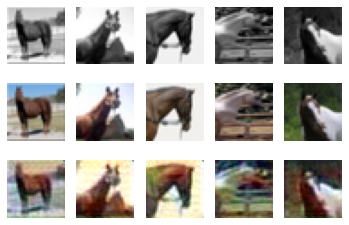

24 Generator Train Losses: 15.796328592300416
24 Discriminator Train Losses: 0.007242467997130007


24 Generator Validation Losses: 19.6170804977417
24 Discriminator Validation Losses: 0.0573097922548186
Train Images Results


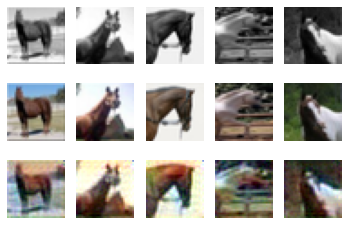

Final Validation Images Results


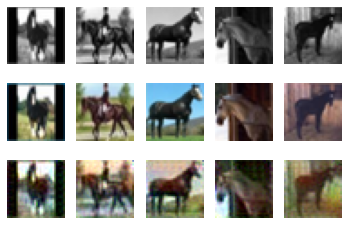

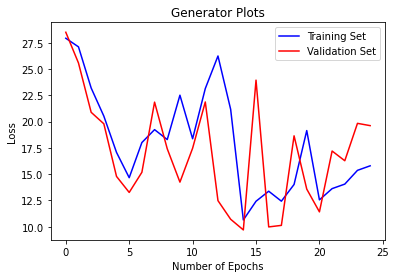

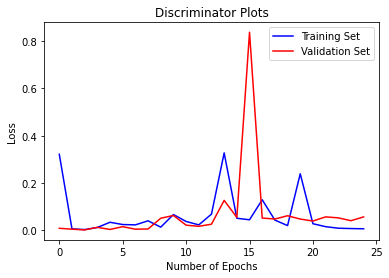

In [131]:
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "Generator",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.0001, 
    "batch_size": 50,
    "epochs": 25,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
    "lambda_l1": 50,
}
args.update(args_dict)
cnn = train_modified(args)

## Part 3. New Data [5 pt]
Retrieve sample pictures from online and demonstrate how well your best model performs. Provide all your code.

In [132]:
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import torchvision
import torch
from torchvision import datasets, transforms
from PIL import Image

In [133]:
!unzip "/content/test_images.zip" -d "/content/horse"

Archive:  /content/test_images.zip
replace /content/horse/test_images/1.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
  inflating: /content/horse/test_images/1.jpg  
  inflating: /content/horse/test_images/10.jpg  
  inflating: /content/horse/test_images/2.jpg  
  inflating: /content/horse/test_images/3.jpg  
  inflating: /content/horse/test_images/4.jpg  
  inflating: /content/horse/test_images/5.jpg  
  inflating: /content/horse/test_images/6.jpg  
  inflating: /content/horse/test_images/7.jpg  
  inflating: /content/horse/test_images/8.jpg  
  inflating: /content/horse/test_images/9.jpg  


In [134]:
transform = transforms.Compose([transforms.ToTensor()])

transform_grey = transforms.Compose([transforms.Grayscale(),transforms.ToTensor()
          ])
test_set = datasets.ImageFolder('/content/horse',transform = transform)  
grey_set = datasets.ImageFolder('/content/horse',transform = transform_grey)  

In [135]:
device = torch.device('cuda')

In [136]:
convert_to_image = transforms.Compose([transforms.ToPILImage(), transforms.Resize((128, 128))])

In [137]:
#loaded_cnn = pickle.load(open(filename, 'rb'))
#criterian = nn.BCELoss()
loss = 0
cnn.eval()
discriminator = Discriminator(args.kernel,args.num_filters)
discriminator.to(device)

Discriminator(
  (upconv_input): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (upconv_label): Sequential(
    (0): Conv2d(1, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (downconv1): Sequential(
    (0): Conv2d(128, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (downconv2): Sequential(
    (0): ConvTranspose2d(64, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.

/usr/local/lib/python3.7/dist-packages/torch/nn/modules/loss.py:530: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 3, 32, 32])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


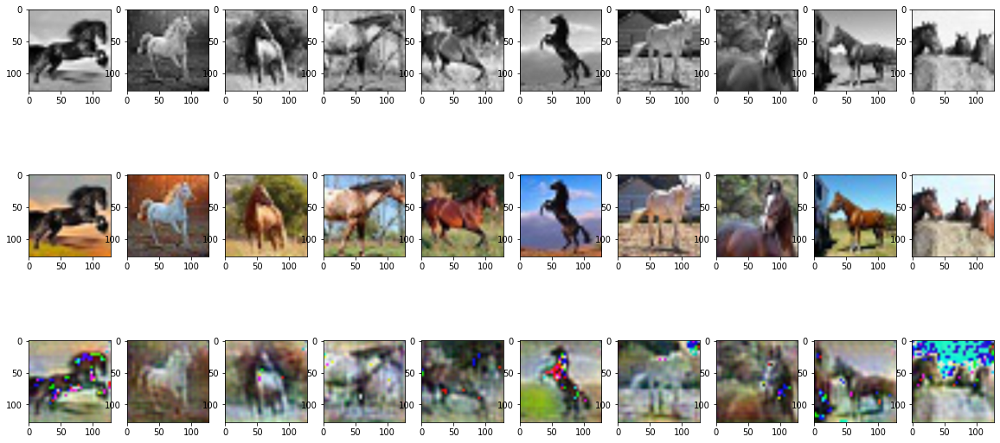

In [138]:

i = 0
fig,ax = plt.subplots(3,10,figsize = (20,10))
#fig.tight_layout()
for imgs_in_batch, labels in iter(torch.utils.data.DataLoader(grey_set,1)):
    imgs_in_batch = imgs_in_batch.to(device)
    noise = Variable(torch.randn(1,1,32,32)).cuda()
    fake_images = cnn(noise,imgs_in_batch)
    labels = torch.ones(1).cuda()
    d_fake_loss = criterian(fake_images,labels)
    
    # Displaying Images
    gray_image = convert_to_image(imgs_in_batch[0])
    actual_image = convert_to_image(test_set[i][0])
    colored_image = convert_to_image(fake_images[0])


    ax[0,i].imshow(gray_image, cmap='gray')
    ax[1,i].imshow(actual_image)
    ax[2,i].imshow(colored_image)
    i = i+1
plt.show()

### Saving to HTML
Detailed instructions for saving to HTML can be found <a href="https://stackoverflow.com/questions/53460051/convert-ipynb-notebook-to-html-in-google-colab/64487858#64487858">here</a>. Provided below are a summary of the instructions:

(1) download your ipynb file by clicking on File->Download.ipynb

(2) reupload your file to the temporary Google Colab storage (you can access the temporary storage from the tab to the left)

(3) run the following:

In [139]:
%%shell
jupyter nbconvert --to html LAB_3_Generating_Data.ipynb

[NbConvertApp] WARNING | pattern 'LAB_3_Generating_Data.ipynb' matched no files
This application is used to convert notebook files (*.ipynb)
        to various other formats.


Options
The options below are convenience aliases to configurable class-options,
as listed in the "Equivalent to" description-line of the aliases.
To see all configurable class-options for some <cmd>, use:
    <cmd> --help-all

--debug
    set log level to logging.DEBUG (maximize logging output)
    Equivalent to: [--Application.log_level=10]
--show-config
    Show the application's configuration (human-readable format)
    Equivalent to: [--Application.show_config=True]
--show-config-json
    Show the application's configuration (json format)
    Equivalent to: [--Application.show_config_json=True]
--generate-config
    generate default config file
    Equivalent to: [--JupyterApp.generate_config=True]
-y
    Answer yes to any questions instead of prompting.
    Equivalent to: [--JupyterApp.answer_yes=True]
--e

CalledProcessError: ignored

(4) the html file will be available for download in the temporary Google Colab storage

(5) review the html file and make sure all the results are visible before submitting your assignment to Quercus